# 我的資料

In [1]:
from geoalchemy2 import Geometry,WKTElement
from sqlalchemy import create_engine
from sqlalchemy.types import VARCHAR, Float, Integer,TIMESTAMP,JSON,Date
import geopandas as gpd
import pandas as pd
import keras
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM,Dropout
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error
from keras import optimizers
import numpy
import matplotlib.pyplot as plt
import pandas
import math
import contextily as cx
server_ip='140.137.37.194'
engine = create_engine('postgresql://postgres:Co43270131@%s:5432/hyxen' %(server_ip), use_batch_mode=True, pool_size=10, max_overflow=20)

In [2]:
sql='''
SELECT * FROM chi."lstm_NOT_home_cyclic"
'''
lstm_NOT_home_cyclic=gpd.GeoDataFrame.from_postgis(sql, engine, geom_col='geom' )
#lstm_NOT_home_cyclic

In [3]:
sql='''
SELECT * FROM chi."台北新北_4326"
'''
taipei=gpd.GeoDataFrame.from_postgis(sql, engine, geom_col='geom')
taipei.to_crs('EPSG:3826',inplace=True)


In [4]:
sql='''
SELECT * FROM chi."lstm_NOT_app_urser_cyclic"
'''
lstm_app_cyclic=gpd.GeoDataFrame.from_postgis(sql, engine, geom_col='geom' )

In [5]:
lstm_app_cyclic=lstm_app_cyclic.rename(columns={'device_id':'device_id_x'})
lstm_app_cyclic.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 77650 entries, 0 to 77649
Data columns (total 43 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   device_id_x       77650 non-null  object  
 1   to_date           77650 non-null  object  
 2   km2               77650 non-null  float64 
 3   CODEBASE          77650 non-null  object  
 4   TOWN              77650 non-null  object  
 5   COUNTY            77650 non-null  object  
 6   醫療院所家數            77650 non-null  object  
 7   老人安養機構家數          77650 non-null  object  
 8   社區照顧關懷據點家數        77650 non-null  object  
 9   兒童福利服務機構家數        77650 non-null  object  
 10  婦幼福利服務機構家數        77650 non-null  object  
 11  老人安養、養護、長期照護機構家數  77650 non-null  object  
 12  居家服務支援中心家數        77650 non-null  object  
 13  老人服務中心家數          77650 non-null  object  
 14  立案老人福利團體家數        77650 non-null  object  
 15  身心障礙福利機構家數        77650 non-null  object  
 16  少年福利服務機構家數    

In [6]:
lstm_app_cyclic.drop(columns='date_part_cos',axis=0,inplace=True)
lstm_app_cyclic.columns

Index(['device_id_x', 'to_date', 'km2', 'CODEBASE', 'TOWN', 'COUNTY', '醫療院所家數',
       '老人安養機構家數', '社區照顧關懷據點家數', '兒童福利服務機構家數', '婦幼福利服務機構家數',
       '老人安養、養護、長期照護機構家數', '居家服務支援中心家數', '老人服務中心家數', '立案老人福利團體家數',
       '身心障礙福利機構家數', '少年福利服務機構家數', '連鎖便利商店家數', '工商業總家數', '農、林、漁、牧業',
       '礦業及土石採取業', '製造業', '電力及燃氣供應業', '用水供應及污染整治業', '營造業', '批發及零售業', '運輸及倉儲業',
       '住宿及餐飲業', '資訊及通訊傳播業', '金融及保險業', '不動產業', '專業、科學及技術服務業', '支援服務業',
       '公共行政及國防；強制性社會安全', '教育服務業', '醫療保健及社會工作服務業', '藝術、娛樂及休閒服務業', '其他服務業',
       'date_part_sin', 'hr_sin', 'hr_cos', 'geom'],
      dtype='object')

In [7]:
lstm_app_cyclic=lstm_app_cyclic.to_crs(epsg=3826)

In [8]:
lstm_app_cyclic.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 77650 entries, 0 to 77649
Data columns (total 42 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   device_id_x       77650 non-null  object  
 1   to_date           77650 non-null  object  
 2   km2               77650 non-null  float64 
 3   CODEBASE          77650 non-null  object  
 4   TOWN              77650 non-null  object  
 5   COUNTY            77650 non-null  object  
 6   醫療院所家數            77650 non-null  object  
 7   老人安養機構家數          77650 non-null  object  
 8   社區照顧關懷據點家數        77650 non-null  object  
 9   兒童福利服務機構家數        77650 non-null  object  
 10  婦幼福利服務機構家數        77650 non-null  object  
 11  老人安養、養護、長期照護機構家數  77650 non-null  object  
 12  居家服務支援中心家數        77650 non-null  object  
 13  老人服務中心家數          77650 non-null  object  
 14  立案老人福利團體家數        77650 non-null  object  
 15  身心障礙福利機構家數        77650 non-null  object  
 16  少年福利服務機構家數    

In [9]:
lstm_app_cyclic['工商業總家數']=pd.to_numeric(lstm_app_cyclic['工商業總家數'], downcast='float')
lstm_app_cyclic['農、林、漁、牧業']=pd.to_numeric(lstm_app_cyclic['農、林、漁、牧業'], downcast='float')
lstm_app_cyclic['礦業及土石採取業']=pd.to_numeric(lstm_app_cyclic['礦業及土石採取業'], downcast='float')
lstm_app_cyclic['製造業']=pd.to_numeric(lstm_app_cyclic['製造業'], downcast='float')
lstm_app_cyclic['電力及燃氣供應業']=pd.to_numeric(lstm_app_cyclic['電力及燃氣供應業'], downcast='float')
lstm_app_cyclic['用水供應及污染整治業']=pd.to_numeric(lstm_app_cyclic['用水供應及污染整治業'], downcast='float')
lstm_app_cyclic['營造業']=pd.to_numeric(lstm_app_cyclic['營造業'], downcast='float')
lstm_app_cyclic['批發及零售業']=pd.to_numeric(lstm_app_cyclic['批發及零售業'], downcast='float')
lstm_app_cyclic['運輸及倉儲業']=pd.to_numeric(lstm_app_cyclic['運輸及倉儲業'], downcast='float')
lstm_app_cyclic['住宿及餐飲業']=pd.to_numeric(lstm_app_cyclic['住宿及餐飲業'], downcast='float')
lstm_app_cyclic['資訊及通訊傳播業']=pd.to_numeric(lstm_app_cyclic['資訊及通訊傳播業'], downcast='float')
lstm_app_cyclic['金融及保險業']=pd.to_numeric(lstm_app_cyclic['金融及保險業'], downcast='float')
lstm_app_cyclic['不動產業']=pd.to_numeric(lstm_app_cyclic['不動產業'], downcast='float')
lstm_app_cyclic['專業、科學及技術服務業']=pd.to_numeric(lstm_app_cyclic['專業、科學及技術服務業'], downcast='float')
lstm_app_cyclic['支援服務業']=pd.to_numeric(lstm_app_cyclic['支援服務業'], downcast='float')
lstm_app_cyclic['藝術、娛樂及休閒服務業']=pd.to_numeric(lstm_app_cyclic['藝術、娛樂及休閒服務業'], downcast='float')
lstm_app_cyclic['其他服務業']=pd.to_numeric(lstm_app_cyclic['其他服務業'], downcast='float')
lstm_app_cyclic['公共行政及國防；強制性社會安全']=pd.to_numeric(lstm_app_cyclic['公共行政及國防；強制性社會安全'], downcast='float')
lstm_app_cyclic['教育服務業']=pd.to_numeric(lstm_app_cyclic['教育服務業'], downcast='float')
lstm_app_cyclic['醫療保健及社會工作服務業']=pd.to_numeric(lstm_app_cyclic['醫療保健及社會工作服務業'], downcast='float')
#dataset.info()

In [10]:
lstm_app_cyclic=lstm_app_cyclic[['device_id_x','工商業總家數','農、林、漁、牧業'
                              ,'礦業及土石採取業','製造業','電力及燃氣供應業'
                              ,'用水供應及污染整治業','營造業','批發及零售業'
                              ,'運輸及倉儲業','住宿及餐飲業','資訊及通訊傳播業','金融及保險業','不動產業','專業、科學及技術服務業'
                              ,'支援服務業','公共行政及國防；強制性社會安全','教育服務業','醫療保健及社會工作服務業',
                              '藝術、娛樂及休閒服務業','其他服務業','date_part_sin','hr_sin','hr_cos','geom']]

In [11]:
from shapely.geometry import Point
lstm_NOT_home_cyclic['center_point']=lstm_NOT_home_cyclic.center.apply(lambda x: Point(eval(x)))
#轉座標二度分帶
lstm_NOT_home_cyclic = gpd.GeoDataFrame(lstm_NOT_home_cyclic, geometry='center_point', crs={'init': 'epsg:3826'})
lstm_NOT_home_cyclic = gpd.GeoDataFrame(lstm_NOT_home_cyclic, geometry='geom', crs={'init': 'epsg:4326'})

#lstm_NOT_home_cyclic.crs = {'init' :'epsg:3826'} # 避免資料沒設，這邊再重新給一次

lstm_NOT_home_cyclic=lstm_NOT_home_cyclic.to_crs(epsg=3826)
#lstm_NOT_home_cyclic.crs


C:\Users\GIS519\Anaconda3\envs\python38\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


In [12]:
## 座標歸一化
lstm_NOT_home_cyclic["geom_x"] = lstm_NOT_home_cyclic.centroid.x
lstm_NOT_home_cyclic["geom_y"] = lstm_NOT_home_cyclic.centroid.y
lstm_NOT_home_cyclic["center_x"] = lstm_NOT_home_cyclic.center_point.x
lstm_NOT_home_cyclic["center_y"] = lstm_NOT_home_cyclic.center_point.y

In [13]:
lstm_NOT_home_cyclic['geom_x_median']=lstm_NOT_home_cyclic['geom_x']/lstm_NOT_home_cyclic["geom_x"].median()
lstm_NOT_home_cyclic['geom_y_median']=lstm_NOT_home_cyclic['geom_y']/lstm_NOT_home_cyclic["geom_y"].median()
lstm_NOT_home_cyclic['center_x_median']=lstm_NOT_home_cyclic['center_x']/lstm_NOT_home_cyclic["center_x"].median()
lstm_NOT_home_cyclic['center_y_median']=lstm_NOT_home_cyclic['center_y']/lstm_NOT_home_cyclic["center_y"].median()
lstm_NOT_home_cyclic

,distance,device_id_x,PK,to_date_x,center,radius,km2,angle_sin,angle_cos,hr_sin,...,geom,center_point,geom_x,geom_y,center_x,center_y,geom_x_median,geom_y_median,center_x_median,center_y_median
0,0.000000,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,2020-02-24,"(275615.282273069,2769250.7677608803)",3383.320439,35.903623,NaN,NaN,-0.631088,...,POINT (246741.331 2745875.100),POINT (275615.282 2769250.768),246741.331173,2.745875e+06,275615.282273,2.769251e+06,0.841840,0.993186,0.940818,1.001986
1,18164.751546,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,2020-02-24,"(275615.282273069,2769250.7677608803)",3383.320439,35.903623,0.754604,-0.656181,-0.398401,...,POINT (262921.102 2754131.807),POINT (275615.282 2769250.768),262921.102041,2.754132e+06,275615.282273,2.769251e+06,0.897043,0.996172,0.940818,1.001986
2,22719.715908,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,2020-02-24,"(275615.282273069,2769250.7677608803)",3383.320439,35.903623,0.864543,0.502558,-0.398401,...,POINT (273370.209 2774306.089),POINT (275615.282 2769250.768),273370.209082,2.774306e+06,275615.282273,2.769251e+06,0.932694,1.003469,0.940818,1.001986
3,2570.769435,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,2020-02-24,"(275615.282273069,2769250.7677608803)",3383.320439,35.903623,0.324532,-0.945875,0.136167,...,POINT (275897.858 2774774.967),POINT (275615.282 2769250.768),275897.857969,2.774775e+06,275615.282273,2.769251e+06,0.941318,1.003639,0.940818,1.001986
4,8752.090014,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,2020-02-24,"(275615.282273069,2769250.7677608803)",3383.320439,35.903623,-0.961196,0.275866,0.398401,...,POINT (280890.410 2767586.538),POINT (275615.282 2769250.768),280890.409501,2.767587e+06,275615.282273,2.769251e+06,0.958351,1.001039,0.940818,1.001986
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59472,3950.799100,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,2020-09-11,"(304806.2732734045,2768178.70019949)",143.329214,0.064435,0.377725,-0.925918,-0.816970,...,POINT (305185.487 2768440.665),POINT (304806.273 2768178.700),305185.486504,2.768441e+06,304806.273273,2.768179e+06,1.041242,1.001348,1.040462,1.001598
59473,356.453823,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,2020-09-11,"(304806.2732734045,2768178.70019949)",143.329214,0.064435,-0.428274,0.903649,-0.816970,...,POINT (305258.917 2768091.857),POINT (304806.273 2768178.700),305258.917018,2.768092e+06,304806.273273,2.768179e+06,1.041493,1.001221,1.040462,1.001598
59474,409.627820,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,2020-09-11,"(304806.2732734045,2768178.70019949)",143.329214,0.064435,-0.547825,0.836593,-0.631088,...,POINT (305149.291 2768486.543),POINT (304806.273 2768178.700),305149.291100,2.768487e+06,304806.273273,2.768179e+06,1.041119,1.001364,1.040462,1.001598
59475,0.000000,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,2020-09-11,"(304806.2732734045,2768178.70019949)",143.329214,0.064435,0.000000,1.000000,-0.631088,...,POINT (305149.291 2768486.543),POINT (304806.273 2768178.700),305149.291100,2.768487e+06,304806.273273,2.768179e+06,1.041119,1.001364,1.040462,1.001598


In [14]:
#合併lstm_app_cyclic跟lstm_NOT_home_cyclic欄位
all_lstm=pd.merge(lstm_app_cyclic,lstm_NOT_home_cyclic,on=['device_id_x','hr_sin','hr_cos','geom'])
all_lstm

,device_id_x,工商業總家數,農、林、漁、牧業,礦業及土石採取業,製造業,電力及燃氣供應業,用水供應及污染整治業,營造業,批發及零售業,運輸及倉儲業,...,date_part_cos,center_point,geom_x,geom_y,center_x,center_y,geom_x_median,geom_y_median,center_x_median,center_y_median
0,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,-0.222521,POINT (274665.845 2773224.612),294201.822121,2.767117e+06,274665.844553,2.773225e+06,1.003768,1.000869,0.937577,1.003424
1,pYiq1FpPClF+Mo/9oPvq5A95TChJRo481L8EQY+jQqtuuG...,72.0,0.0,0.0,1.0,0.0,0.0,1.0,40.0,1.0,...,-0.222521,POINT (302980.057 2768858.593),301010.241206,2.770861e+06,302980.056864,2.768859e+06,1.026997,1.002223,1.034229,1.001844
2,fuQDiEk0Z4uRt7aWiEaJVyr5waM0fK28VhPlA9P656DaDk...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,-0.900969,POINT (292651.606 2764305.128),293744.582945,2.763561e+06,292651.606472,2.764305e+06,1.002208,0.999582,0.998972,1.000197
3,jLWdBuQ4p4IE18Jse0fzj8I4r7zf4kuyEIEXJkZz2rPYYH...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.623490,POINT (294013.790 2764281.036),293807.993599,2.764186e+06,294013.789608,2.764281e+06,1.002424,0.999809,1.003622,1.000188
4,jLWdBuQ4p4IE18Jse0fzj8I4r7zf4kuyEIEXJkZz2rPYYH...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.623490,POINT (294013.790 2764281.036),293807.993599,2.764186e+06,294013.789608,2.764281e+06,1.002424,0.999809,1.003622,1.000188
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78348,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,18.0,1.0,0.0,0.0,0.0,0.0,2.0,8.0,0.0,...,-0.222521,POINT (311706.317 2658289.519),311690.199929,2.658278e+06,311706.317303,2.658290e+06,1.063435,0.961502,1.064016,0.961838
78349,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,18.0,1.0,0.0,0.0,0.0,0.0,2.0,8.0,0.0,...,-0.222521,POINT (311706.317 2658289.519),311699.436201,2.658271e+06,311706.317303,2.658290e+06,1.063467,0.961499,1.064016,0.961838
78350,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,18.0,0.0,0.0,1.0,0.0,0.0,0.0,5.0,0.0,...,-0.900969,POINT (313734.278 2752977.575),311427.863677,2.658891e+06,313734.278415,2.752978e+06,1.062540,0.961723,1.070938,0.996098
78351,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,36.0,0.0,1.0,3.0,0.0,0.0,3.0,13.0,3.0,...,-0.222521,POINT (311706.317 2658289.519),311717.636221,2.658306e+06,311706.317303,2.658290e+06,1.063529,0.961512,1.064016,0.961838


one_user=lstm_NOT_home_cyclic[lstm_NOT_home_cyclic['device_id_x']=='S1jG1ed8rMa3QGHOMzVurbD5g0Ij/hbU9x6XjF1vUcrbcsJIwCJCJ3NUqlsVMWvh']
ax = one_user.plot(figsize=(16,16))
cx.add_basemap(ax=ax,crs='EPSG:3826')





In [15]:
#去除台北市以外的點
import geopandas as gpd

cities_with_one_user= gpd.sjoin(all_lstm, taipei, how="inner")

#ax = cities_with_one_user.plot(figsize=(16,16))
#cx.add_basemap(ax=ax,crs='EPSG:3826')

In [16]:
dataset=cities_with_one_user.copy()
dataset

,device_id_x,工商業總家數,農、林、漁、牧業,礦業及土石採取業,製造業,電力及燃氣供應業,用水供應及污染整治業,營造業,批發及零售業,運輸及倉儲業,...,geom_y_median,center_x_median,center_y_median,index_right,id,fid,COUNTYID,COUNTYCODE,COUNTYNAME,COUNTYENG
0,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.000869,0.937577,1.003424,1,10,10,F,65000,新北市,New Taipei City
2,fuQDiEk0Z4uRt7aWiEaJVyr5waM0fK28VhPlA9P656DaDk...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.999582,0.998972,1.000197,1,10,10,F,65000,新北市,New Taipei City
3,jLWdBuQ4p4IE18Jse0fzj8I4r7zf4kuyEIEXJkZz2rPYYH...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.999809,1.003622,1.000188,1,10,10,F,65000,新北市,New Taipei City
4,jLWdBuQ4p4IE18Jse0fzj8I4r7zf4kuyEIEXJkZz2rPYYH...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.999809,1.003622,1.000188,1,10,10,F,65000,新北市,New Taipei City
5,jLWdBuQ4p4IE18Jse0fzj8I4r7zf4kuyEIEXJkZz2rPYYH...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.999809,1.003622,1.000188,1,10,10,F,65000,新北市,New Taipei City
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78334,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,54.0,0.0,0.0,4.0,0.0,0.0,4.0,18.0,0.0,...,1.001292,1.041115,1.001598,0,9,9,A,63000,臺北市,Taipei City
78335,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,54.0,0.0,0.0,4.0,0.0,0.0,4.0,18.0,0.0,...,1.001290,1.041115,1.001598,0,9,9,A,63000,臺北市,Taipei City
78336,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,54.0,0.0,0.0,4.0,0.0,0.0,4.0,18.0,0.0,...,1.001290,1.041115,1.001598,0,9,9,A,63000,臺北市,Taipei City
78337,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,5.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,1.001314,1.041498,1.001678,0,9,9,A,63000,臺北市,Taipei City


dataset=cities_with_one_user[['device_id_x','geom_x_median','geom_y_median','date_part_sin','hr_sin']]
dataset

dataset=cities_with_one_user[['device_id_x','distance','angle_sin','angle_cos','radius','km2','hr_sin','hr_cos','date_part_sin',
                             'date_part_cos','geom_x_median','geom_y_median','center_x_median','center_y_median']]
dataset
# need MinMaxScaler 1,4,5

In [17]:
dataset.dropna(axis=0, how='any', inplace=True)

In [18]:
dataset.info(verbose=True)

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 36187 entries, 0 to 78338
Data columns (total 51 columns):
 #   Column           Non-Null Count  Dtype   
---  ------           --------------  -----   
 0   device_id_x      36187 non-null  object  
 1   工商業總家數           36187 non-null  float32 
 2   農、林、漁、牧業         36187 non-null  float32 
 3   礦業及土石採取業         36187 non-null  float32 
 4   製造業              36187 non-null  float32 
 5   電力及燃氣供應業         36187 non-null  float32 
 6   用水供應及污染整治業       36187 non-null  float32 
 7   營造業              36187 non-null  float32 
 8   批發及零售業           36187 non-null  float32 
 9   運輸及倉儲業           36187 non-null  float32 
 10  住宿及餐飲業           36187 non-null  float32 
 11  資訊及通訊傳播業         36187 non-null  float32 
 12  金融及保險業           36187 non-null  float32 
 13  不動產業             36187 non-null  float32 
 14  專業、科學及技術服務業      36187 non-null  float32 
 15  支援服務業            36187 non-null  float32 
 16  公共行政及國防；強制性社會安全  36187 non-null 

dataset = dataset.values
dataset = dataset.astype('float32')
dataset
['distance','angle_sin','angle_cos','radius', 'km2', 'hr_sin', 'hr_cos', 'date_part_sin', 'date_part_cos', 'geom_x_median', 'geom_y_median', 'center_x_median', 'center_y_median']

# 區分兩筆資料，一份維土地利用，一份維算座標
#dataset.info(verbose=True)

#dataset.iloc[1:,51:71] #土地利用標籤
#dataset.iloc[1:,91:93] #座標標籤
#dataset.iloc[1:,91:93]
ironman8 = dataset.iloc[1:,91:93].merge(dataset.iloc[1:,51:71], how='outer', left_index=True, right_index=True)
ironman8

#dataset.iloc[1:,1:3]
#dataset.iloc[0:-1,:]
df_outer = ironman8.reset_index(drop=True).merge(dataset.iloc[0:-1,:].reset_index(drop=True), how='outer', left_index=True, right_index=True)
#df_outer.info(verbose=True)

x_scaler1= MinMaxScaler(feature_range=(0, 1)).fit(dataset.iloc[0:-1,1:])
truths_trans_y = dataset.iloc[1:,1:3].copy().reset_index(drop=True)#yscaler.fit_transform(dataset.iloc[1:,0:3])
dataset_trans_right = x_scaler1.fit_transform(dataset.iloc[0:-1,[1,4,5]])

truths_trans_y.columns=['distance_y','angle_sin_y',]
dataset_trans_right = pd.DataFrame(dataset_trans_right,columns=['distance','radius', 'km2'])
dataset_trans_left = dataset.iloc[0:-1,[0,2,3,6,7,8,9,10,11,12,13]].copy().reset_index(drop=True)

df_outer = truths_trans_y.merge(dataset_trans_left, how='outer', left_index=True, right_index=True)
df_outer = df_outer.merge(dataset_trans_right, how='outer', left_index=True, right_index=True)

# normalize the datasete把數值介於到0-1之間
scaler = MinMaxScaler(feature_range=(0, 1)).fit(dataset)
dataset = scaler.fit_transform(dataset)
dataset

import numpy as np
#正規化
def normalize(train):
    train_norm = train.apply(lambda x: (x - np.mean(x)) / (np.max(x) - np.min(x)))
    return train_norm

data=normalize(dataset)

data

### 土地利用預測

In [19]:
dataset.info(verbose=True)

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 36187 entries, 0 to 78338
Data columns (total 51 columns):
 #   Column           Non-Null Count  Dtype   
---  ------           --------------  -----   
 0   device_id_x      36187 non-null  object  
 1   工商業總家數           36187 non-null  float32 
 2   農、林、漁、牧業         36187 non-null  float32 
 3   礦業及土石採取業         36187 non-null  float32 
 4   製造業              36187 non-null  float32 
 5   電力及燃氣供應業         36187 non-null  float32 
 6   用水供應及污染整治業       36187 non-null  float32 
 7   營造業              36187 non-null  float32 
 8   批發及零售業           36187 non-null  float32 
 9   運輸及倉儲業           36187 non-null  float32 
 10  住宿及餐飲業           36187 non-null  float32 
 11  資訊及通訊傳播業         36187 non-null  float32 
 12  金融及保險業           36187 non-null  float32 
 13  不動產業             36187 non-null  float32 
 14  專業、科學及技術服務業      36187 non-null  float32 
 15  支援服務業            36187 non-null  float32 
 16  公共行政及國防；強制性社會安全  36187 non-null 

In [20]:
#dataset.reset_index(inplace=True)
dataset

,device_id_x,工商業總家數,農、林、漁、牧業,礦業及土石採取業,製造業,電力及燃氣供應業,用水供應及污染整治業,營造業,批發及零售業,運輸及倉儲業,...,geom_y_median,center_x_median,center_y_median,index_right,id,fid,COUNTYID,COUNTYCODE,COUNTYNAME,COUNTYENG
0,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.000869,0.937577,1.003424,1,10,10,F,65000,新北市,New Taipei City
2,fuQDiEk0Z4uRt7aWiEaJVyr5waM0fK28VhPlA9P656DaDk...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.999582,0.998972,1.000197,1,10,10,F,65000,新北市,New Taipei City
3,jLWdBuQ4p4IE18Jse0fzj8I4r7zf4kuyEIEXJkZz2rPYYH...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.999809,1.003622,1.000188,1,10,10,F,65000,新北市,New Taipei City
4,jLWdBuQ4p4IE18Jse0fzj8I4r7zf4kuyEIEXJkZz2rPYYH...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.999809,1.003622,1.000188,1,10,10,F,65000,新北市,New Taipei City
5,jLWdBuQ4p4IE18Jse0fzj8I4r7zf4kuyEIEXJkZz2rPYYH...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.999809,1.003622,1.000188,1,10,10,F,65000,新北市,New Taipei City
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78334,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,54.0,0.0,0.0,4.0,0.0,0.0,4.0,18.0,0.0,...,1.001292,1.041115,1.001598,0,9,9,A,63000,臺北市,Taipei City
78335,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,54.0,0.0,0.0,4.0,0.0,0.0,4.0,18.0,0.0,...,1.001290,1.041115,1.001598,0,9,9,A,63000,臺北市,Taipei City
78336,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,54.0,0.0,0.0,4.0,0.0,0.0,4.0,18.0,0.0,...,1.001290,1.041115,1.001598,0,9,9,A,63000,臺北市,Taipei City
78337,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,5.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,1.001314,1.041498,1.001678,0,9,9,A,63000,臺北市,Taipei City


#輸入值
#df_outer.info(verbose=True)
#df_outer.iloc[23:97]
#df_outer.iloc[113:115]
land_x =df_outer.iloc[:,23:97].merge(df_outer.iloc[:,113:115], how='outer', left_index=True, right_index=True)
land_x.info(verbose=True)

In [302]:
#len(dataset['device_id_x'].unique())
len(dataset)

36187

In [20]:
dataset.columns.tolist()

['device_id_x',
 '工商業總家數',
 '農、林、漁、牧業',
 '礦業及土石採取業',
 '製造業',
 '電力及燃氣供應業',
 '用水供應及污染整治業',
 '營造業',
 '批發及零售業',
 '運輸及倉儲業',
 '住宿及餐飲業',
 '資訊及通訊傳播業',
 '金融及保險業',
 '不動產業',
 '專業、科學及技術服務業',
 '支援服務業',
 '公共行政及國防；強制性社會安全',
 '教育服務業',
 '醫療保健及社會工作服務業',
 '藝術、娛樂及休閒服務業',
 '其他服務業',
 'date_part_sin_x',
 'hr_sin',
 'hr_cos',
 'geom',
 'distance',
 'PK',
 'to_date_x',
 'center',
 'radius',
 'km2',
 'angle_sin',
 'angle_cos',
 'date_part_sin_y',
 'date_part_cos',
 'center_point',
 'geom_x',
 'geom_y',
 'center_x',
 'center_y',
 'geom_x_median',
 'geom_y_median',
 'center_x_median',
 'center_y_median',
 'index_right',
 'id',
 'fid',
 'COUNTYID',
 'COUNTYCODE',
 'COUNTYNAME',
 'COUNTYENG']

### look_back

In [21]:
landlist_x =[
'device_id_x',
 '工商業總家數',
 '農、林、漁、牧業',
 '礦業及土石採取業',
 '製造業',
 '電力及燃氣供應業',
 '用水供應及污染整治業',
 '營造業',
 '批發及零售業',
 '運輸及倉儲業',
 '住宿及餐飲業',
 '資訊及通訊傳播業',
 '金融及保險業',
 '不動產業',
 '專業、科學及技術服務業',
 '支援服務業',
 '公共行政及國防；強制性社會安全',
 '教育服務業',
 '醫療保健及社會工作服務業',
 '藝術、娛樂及休閒服務業',
 '其他服務業',
 'date_part_sin_x',
 'hr_sin',
 'hr_cos',
 'geom_x_median',
 'geom_y_median'
]

In [22]:
lonlist_x=[
'device_id_x',
 'hr_sin',
 'date_part_sin_y',
 'geom_x_median',
 'geom_y_median'
]

In [23]:
# convert an array of values into a dataset matrix將值數組轉換為數據集矩陣
def create_landdataset(dataset, look_back=1):
    dataset=dataset[landlist_x]
    dataX, dataY = [], []
    for i in range(len(dataset)-look_back):
        a = dataset.iloc[i:i+look_back,:]
        dataX.append(a)
        dataY.append(dataset.iloc[i + look_back,-25:-5])
    return numpy.array(dataX), numpy.array(dataY)

def create_locdataset(dataset, look_back=1):
    dataset=dataset[lonlist_x]
    dataX, dataY = [], []
    for i in range(len(dataset)-look_back):
        a = dataset.iloc[i:i+look_back,:]
        dataX.append(a)
        dataY.append(dataset.iloc[i + look_back, 3:])
    return numpy.array(dataX), numpy.array(dataY)

In [24]:
user_list = dataset['device_id_x'].unique().tolist()
len(user_list)

231

In [25]:
# reshape into X=t and Y=t+1
from sklearn.model_selection import train_test_split
import numpy as np
look_back = 4
#Xs = np.empty((0,2,13))
#ys = np.empty((0,3))
user_list = dataset['device_id_x'].unique().tolist()
land_xlist = []
land_ylist = []
land_idlist =[]
loc_xlist = []
loc_ylist = []
loc_idlist =[]
for user_id in user_list:
    one_user=dataset[dataset['device_id_x']==user_id]
    one_user_X_land,one_user_Y_land = create_landdataset(one_user, look_back)
    one_user_X_loc,one_user_Y_loc = create_locdataset(one_user, look_back)
    
    for i in range(len(one_user_X_land)):
        land_xlist.append(one_user_X_land[i,:,1:].reshape(look_back,len(landlist_x)-1))
        land_ylist.append(one_user_Y_land[i,:])
        land_idlist.append(one_user_X_land[i,3,0])
    for i in range(len(one_user_X_loc)):
        loc_xlist.append(one_user_X_loc[i,:,1:].reshape(look_back,len(lonlist_x)-1))
        loc_ylist.append(one_user_Y_loc[i,:])
        loc_idlist.append(one_user_X_loc[i,3,0])
    
landAllX = np.array(land_xlist)
landAllY = np.array(land_ylist)

land_X_train, land_X_test, land_y_train, land_y_test = train_test_split(landAllX, landAllY, test_size=0.2, random_state=12)
land_X_test, land_X_val, land_y_test, land_y_val = train_test_split(land_X_test, land_y_test, test_size=0.5, random_state=12)

locAllX = np.array(loc_xlist)
locAllY = np.array(loc_ylist)

loc_X_train, loc_X_test, loc_y_train, loc_y_test = train_test_split(locAllX, locAllY, test_size=0.2, random_state=12)
loc_X_test, loc_X_val, loc_y_test, loc_y_val = train_test_split(loc_X_test, loc_y_test, test_size=0.5, random_state=12)

In [26]:
locAllY[0]

array([0.9660174336869132, 0.997832618388419], dtype=object)

In [27]:
# land
land_model = Sequential()
land_model.add(LSTM(10, input_shape=(land_X_train.shape[1], land_X_train.shape[2]),return_sequences=True))
#land_model.add(Dropout(0.2))
land_model.add(LSTM(5, return_sequences=False))
#land_model.add(Dropout(0.5))
land_model.add(Dense(20,activation = "relu"))
#model.add(Dense(1, activation = "tanh"))
adam=optimizers.Adam(lr=0.1, beta_1=0.9, beta_2=0.9, epsilon=None, decay=0.0, amsgrad=False)
land_model.compile(loss='mae', optimizer='adam')
# fit network
#np.seed 亂數種子
history = land_model.fit(land_X_train.astype('float64'), land_y_train.astype('float64'), epochs=300, batch_size=150, validation_data=(land_X_val.astype('float64'), land_y_val.astype('float64')), verbose=2, shuffle=True)

Epoch 1/300
189/189 - 1s - loss: 3.2825 - val_loss: 3.1967
Epoch 2/300
189/189 - 0s - loss: 3.1203 - val_loss: 3.0903
Epoch 3/300
189/189 - 0s - loss: 3.0304 - val_loss: 3.0103
Epoch 4/300
189/189 - 0s - loss: 2.9568 - val_loss: 2.9437
Epoch 5/300
189/189 - 0s - loss: 2.8966 - val_loss: 2.8890
Epoch 6/300
189/189 - 0s - loss: 2.8460 - val_loss: 2.8422
Epoch 7/300
189/189 - 0s - loss: 2.8004 - val_loss: 2.7988
Epoch 8/300
189/189 - 0s - loss: 2.7578 - val_loss: 2.7579
Epoch 9/300
189/189 - 0s - loss: 2.7189 - val_loss: 2.7209
Epoch 10/300
189/189 - 0s - loss: 2.6827 - val_loss: 2.6854
Epoch 11/300
189/189 - 0s - loss: 2.6481 - val_loss: 2.6518
Epoch 12/300
189/189 - 0s - loss: 2.6159 - val_loss: 2.6209
Epoch 13/300
189/189 - 0s - loss: 2.5862 - val_loss: 2.5925
Epoch 14/300
189/189 - 0s - loss: 2.5587 - val_loss: 2.5662
Epoch 15/300
189/189 - 0s - loss: 2.5328 - val_loss: 2.5409
Epoch 16/300
189/189 - 0s - loss: 2.5086 - val_loss: 2.5169
Epoch 17/300
189/189 - 0s - loss: 2.4847 - val_lo

189/189 - 0s - loss: 1.5842 - val_loss: 1.6037
Epoch 138/300
189/189 - 0s - loss: 1.5817 - val_loss: 1.6025
Epoch 139/300
189/189 - 0s - loss: 1.5793 - val_loss: 1.5988
Epoch 140/300
189/189 - 0s - loss: 1.5770 - val_loss: 1.5994
Epoch 141/300
189/189 - 0s - loss: 1.5733 - val_loss: 1.6067
Epoch 142/300
189/189 - 0s - loss: 1.5710 - val_loss: 1.5906
Epoch 143/300
189/189 - 0s - loss: 1.5679 - val_loss: 1.5897
Epoch 144/300
189/189 - 0s - loss: 1.5661 - val_loss: 1.5857
Epoch 145/300
189/189 - 0s - loss: 1.5641 - val_loss: 1.5838
Epoch 146/300
189/189 - 0s - loss: 1.5602 - val_loss: 1.5806
Epoch 147/300
189/189 - 0s - loss: 1.5585 - val_loss: 1.5805
Epoch 148/300
189/189 - 0s - loss: 1.5569 - val_loss: 1.5758
Epoch 149/300
189/189 - 0s - loss: 1.5542 - val_loss: 1.5755
Epoch 150/300
189/189 - 0s - loss: 1.5514 - val_loss: 1.5727
Epoch 151/300
189/189 - 0s - loss: 1.5430 - val_loss: 1.5658
Epoch 152/300
189/189 - 0s - loss: 1.5283 - val_loss: 1.5480
Epoch 153/300
189/189 - 0s - loss: 1.5

Epoch 272/300
189/189 - 0s - loss: 1.3274 - val_loss: 1.3655
Epoch 273/300
189/189 - 0s - loss: 1.3268 - val_loss: 1.3661
Epoch 274/300
189/189 - 0s - loss: 1.3273 - val_loss: 1.3766
Epoch 275/300
189/189 - 0s - loss: 1.3254 - val_loss: 1.3638
Epoch 276/300
189/189 - 0s - loss: 1.3247 - val_loss: 1.3587
Epoch 277/300
189/189 - 0s - loss: 1.3227 - val_loss: 1.3638
Epoch 278/300
189/189 - 0s - loss: 1.3214 - val_loss: 1.3581
Epoch 279/300
189/189 - 0s - loss: 1.3208 - val_loss: 1.3740
Epoch 280/300
189/189 - 0s - loss: 1.3219 - val_loss: 1.3632
Epoch 281/300
189/189 - 0s - loss: 1.3193 - val_loss: 1.3596
Epoch 282/300
189/189 - 0s - loss: 1.3175 - val_loss: 1.3727
Epoch 283/300
189/189 - 0s - loss: 1.3177 - val_loss: 1.3560
Epoch 284/300
189/189 - 0s - loss: 1.3155 - val_loss: 1.3624
Epoch 285/300
189/189 - 0s - loss: 1.3162 - val_loss: 1.3627
Epoch 286/300
189/189 - 0s - loss: 1.3141 - val_loss: 1.3571
Epoch 287/300
189/189 - 0s - loss: 1.3139 - val_loss: 1.3627
Epoch 288/300
189/189 - 

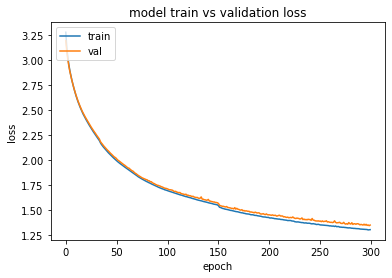

In [28]:
plt.plot(history.history[ 'loss' ]) 
plt.plot(history.history[ 'val_loss' ]) 
plt.title( 'model train vs validation loss' ) 
plt.ylabel( 'loss' ) 
plt.xlabel( 'epoch' ) 
plt.legend([ 'train' , 'val' ], loc= 'upper left' ) 
plt.show()

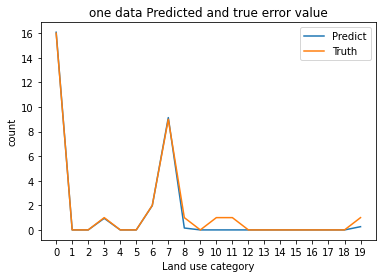

In [198]:
#plt.plot(scaler.inverse_transform(df_outer))
trainPredict = land_model.predict(land_X_train.astype('float64'))
testPredict = land_model.predict(land_X_test.astype('float64'))
#plt.plot(trainPredict[51])
#y是測出來的值，類別x
#plt.scatter
plt.plot(testPredict[12])
plt.plot(land_y_test[12])
plt.legend([ 'Predict' , 'Truth' ]) 
plt.title("one data Predicted and true error value")
plt.xlabel("Land use category")
plt.ylabel("count")
plt.xticks([ i for i in range(20)])

plt.show()

In [30]:
testPredict_df = pd.DataFrame(testPredict, columns = ['工商業總家數','農、林、漁、牧業','礦業及土石採取業',
                                            '製造業','電力及燃氣供應業','用水供應及污染整治業','營造業',
                                            '批發及零售業','運輸及倉儲業','住宿及餐飲業','資訊及通訊傳播業',
                                                    '金融及保險業','不動產業','專業、科學及技術服務業','支援服務業',
                                                    '公共行政及國防；強制性社會安全','教育服務業','醫療保健及社會工作服務業',
                                                    '藝術、娛樂及休閒服務業','其他服務業'])

In [31]:
testPredict_df=testPredict_df.astype(int)


In [32]:
y_test_df = pd.DataFrame(land_y_test, columns = ['工商業總家數','農、林、漁、牧業','礦業及土石採取業',
                                            '製造業','電力及燃氣供應業','用水供應及污染整治業','營造業',
                                            '批發及零售業','運輸及倉儲業','住宿及餐飲業','資訊及通訊傳播業',
                                                    '金融及保險業','不動產業','專業、科學及技術服務業','支援服務業',
                                                    '公共行政及國防；強制性社會安全','教育服務業','醫療保健及社會工作服務業',
                                                    '藝術、娛樂及休閒服務業','其他服務業'])

In [33]:
testPredict_df_sum=testPredict_df.sum(0)
y_test_df_sum=y_test_df.sum(0)
y_test_df_sum=y_test_df_sum.astype(int)

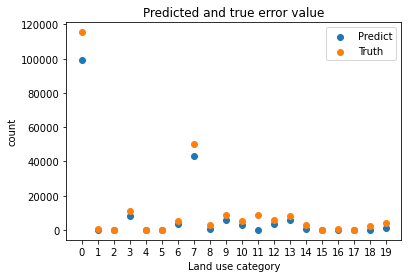

In [34]:
plt.xticks([ i for i in range(20)])
plt.scatter([ i for i in range(20)],testPredict_df_sum , label = "Predict")
plt.scatter([ i for i in range(20)],y_test_df_sum, label = "Truth")
plt.legend() 
plt.title("Predicted and true error value")
plt.xlabel("Land use category")
plt.ylabel("count")
plt.show()

In [35]:
#lon
locmodel = Sequential()
locmodel.add(LSTM(5, input_shape=(loc_X_train.shape[1], loc_X_train.shape[2]),return_sequences=True))
locmodel.add(Dropout(0.2))
locmodel.add(LSTM(5, return_sequences=False))
locmodel.add(Dropout(0.2))
#model.add(Dense(2,activation = "relu"))
locmodel.add(Dense(2))

#model.add(Dense(1, activation = "tanh"))
adam=optimizers.Adam(lr=0.001, beta_1=0.999, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=False)
locmodel.compile(loss='mae', optimizer='adam')

#model.compile(loss='mean_squared_error', optimizer='adam')
# fit network

history = locmodel.fit(loc_X_train.astype('float64'), loc_y_train.astype('float64'), epochs=300, batch_size=250, validation_data=(loc_X_val.astype('float64'), loc_y_val.astype('float64')), verbose=2, shuffle=True)

Epoch 1/300
113/113 - 1s - loss: 0.5858 - val_loss: 0.0776
Epoch 2/300
113/113 - 0s - loss: 0.2119 - val_loss: 0.0959
Epoch 3/300
113/113 - 0s - loss: 0.1879 - val_loss: 0.0932
Epoch 4/300
113/113 - 0s - loss: 0.1733 - val_loss: 0.0848
Epoch 5/300
113/113 - 0s - loss: 0.1575 - val_loss: 0.0728
Epoch 6/300
113/113 - 0s - loss: 0.1438 - val_loss: 0.0658
Epoch 7/300
113/113 - 0s - loss: 0.1301 - val_loss: 0.0546
Epoch 8/300
113/113 - 0s - loss: 0.1159 - val_loss: 0.0517
Epoch 9/300
113/113 - 0s - loss: 0.1003 - val_loss: 0.0375
Epoch 10/300
113/113 - 0s - loss: 0.0878 - val_loss: 0.0278
Epoch 11/300
113/113 - 0s - loss: 0.0754 - val_loss: 0.0170
Epoch 12/300
113/113 - 0s - loss: 0.0634 - val_loss: 0.0145
Epoch 13/300
113/113 - 0s - loss: 0.0524 - val_loss: 0.0121
Epoch 14/300
113/113 - 0s - loss: 0.0415 - val_loss: 0.0109
Epoch 15/300
113/113 - 0s - loss: 0.0313 - val_loss: 0.0122
Epoch 16/300
113/113 - 0s - loss: 0.0224 - val_loss: 0.0102
Epoch 17/300
113/113 - 0s - loss: 0.0158 - val_lo

113/113 - 0s - loss: 0.0030 - val_loss: 0.0021
Epoch 138/300
113/113 - 0s - loss: 0.0030 - val_loss: 0.0021
Epoch 139/300
113/113 - 0s - loss: 0.0030 - val_loss: 0.0023
Epoch 140/300
113/113 - 0s - loss: 0.0030 - val_loss: 0.0022
Epoch 141/300
113/113 - 0s - loss: 0.0030 - val_loss: 0.0023
Epoch 142/300
113/113 - 0s - loss: 0.0030 - val_loss: 0.0023
Epoch 143/300
113/113 - 0s - loss: 0.0030 - val_loss: 0.0021
Epoch 144/300
113/113 - 0s - loss: 0.0030 - val_loss: 0.0021
Epoch 145/300
113/113 - 0s - loss: 0.0030 - val_loss: 0.0021
Epoch 146/300
113/113 - 0s - loss: 0.0030 - val_loss: 0.0021
Epoch 147/300
113/113 - 0s - loss: 0.0030 - val_loss: 0.0021
Epoch 148/300
113/113 - 0s - loss: 0.0030 - val_loss: 0.0021
Epoch 149/300
113/113 - 0s - loss: 0.0030 - val_loss: 0.0022
Epoch 150/300
113/113 - 0s - loss: 0.0030 - val_loss: 0.0022
Epoch 151/300
113/113 - 0s - loss: 0.0030 - val_loss: 0.0023
Epoch 152/300
113/113 - 0s - loss: 0.0030 - val_loss: 0.0021
Epoch 153/300
113/113 - 0s - loss: 0.0

Epoch 272/300
113/113 - 0s - loss: 0.0029 - val_loss: 0.0021
Epoch 273/300
113/113 - 0s - loss: 0.0029 - val_loss: 0.0021
Epoch 274/300
113/113 - 0s - loss: 0.0029 - val_loss: 0.0020
Epoch 275/300
113/113 - 0s - loss: 0.0029 - val_loss: 0.0023
Epoch 276/300
113/113 - 0s - loss: 0.0029 - val_loss: 0.0023
Epoch 277/300
113/113 - 0s - loss: 0.0029 - val_loss: 0.0020
Epoch 278/300
113/113 - 0s - loss: 0.0029 - val_loss: 0.0020
Epoch 279/300
113/113 - 0s - loss: 0.0029 - val_loss: 0.0021
Epoch 280/300
113/113 - 0s - loss: 0.0029 - val_loss: 0.0021
Epoch 281/300
113/113 - 0s - loss: 0.0029 - val_loss: 0.0022
Epoch 282/300
113/113 - 0s - loss: 0.0029 - val_loss: 0.0021
Epoch 283/300
113/113 - 0s - loss: 0.0029 - val_loss: 0.0024
Epoch 284/300
113/113 - 0s - loss: 0.0029 - val_loss: 0.0020
Epoch 285/300
113/113 - 0s - loss: 0.0029 - val_loss: 0.0023
Epoch 286/300
113/113 - 0s - loss: 0.0029 - val_loss: 0.0025
Epoch 287/300
113/113 - 0s - loss: 0.0029 - val_loss: 0.0021
Epoch 288/300
113/113 - 

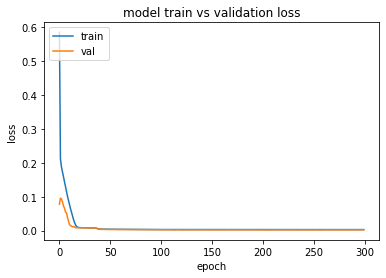

In [36]:
plt.plot(history.history[ 'loss' ]) 
plt.plot(history.history[ 'val_loss' ]) 
plt.title( 'model train vs validation loss' ) 
plt.ylabel( 'loss' ) 
plt.xlabel( 'epoch' ) 
plt.legend([ 'train' , 'val' ], loc= 'upper left' ) 
plt.show()

In [37]:
locAllX[:,3,:]

array([[-0.631087944326053, -0.78183148246803, 0.9660143283910253,
        0.9978433905246246],
       [0.136166649096247, 0.78183148246803, 0.9660174336869132,
        0.997832618388419],
       [-2.44929359829471e-16, 0.0, 0.9659758538695618,
        0.9978427597024433],
       ...,
       [0.398401089846241, 0.78183148246803, 1.0497859076736766,
        1.0000899438152573],
       [-0.398401089846242, 0.433883739117558, 1.0333619503592937,
        1.0017643552302755],
       [-0.398401089846242, 0.433883739117558, 1.0333609408396387,
        1.0017637137839328]], dtype=object)

In [38]:
right_df=pd.DataFrame(locAllX[:,3,:],columns=['hr_sin','date_part_sin','geom_x_median','geom_y_median'])
#含有device_id_x欄位
#device_id_right_df=pd.DataFrame(AllX_device_id[:,3,:],columns=['device_id_x','geom_x_median','geom_y_median','date_part_sin','hr_sin'])
left_df=pd.DataFrame(locAllY,columns=['geom_x_median_true','geom_y_median_true'])
#把AllX拿去做預測
pred = pd.DataFrame(locmodel.predict(locAllX.astype('float64')),columns=['geom_x_median_pred','geom_y_median_pred'])
#把以上四個df串起來
loc_diff_df = pd.concat([pred,left_df,right_df],axis=1)

loc_diff_df[[ 'geom_y_median_pred','geom_y_median_true', 'geom_y_median']] *= lstm_NOT_home_cyclic["geom_y"].median()
loc_diff_df[['geom_x_median_pred', 'geom_x_median_true','geom_x_median']] *=  lstm_NOT_home_cyclic["geom_x"].median()
loc_diff_df
loc_diff_df = gpd.GeoDataFrame(loc_diff_df,geometry=gpd.points_from_xy(loc_diff_df.geom_x_median, loc_diff_df.geom_y_median) )
loc_diff_df['geometry2'] = gpd.points_from_xy(loc_diff_df.geom_x_median_pred, loc_diff_df.geom_y_median_pred)
loc_diff_df['geometry3'] = gpd.points_from_xy(loc_diff_df.geom_x_median_true, loc_diff_df.geom_y_median_true)
loc_diff_df.crs='EPSG:3826'
loc_diff_df['dist_diff'] = loc_diff_df['geometry2'].distance(loc_diff_df['geometry3'])
loc_diff_df['device_id']=loc_idlist
loc_diff_df

,geom_x_median_pred,geom_y_median_pred,geom_x_median_true,geom_y_median_true,hr_sin,date_part_sin,geom_x_median,geom_y_median,geometry,geometry2,geometry3,dist_diff,device_id
0,284980.28125,2765686.00,283137,2.75872e+06,-0.631088,-0.781831,283136,2.75875e+06,POINT (283136.425 2758752.709),POINT (284980.281 2765686.000),POINT (283137.335 2758722.928),7202.834673,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...
1,284542.84375,2765563.25,283125,2.75875e+06,0.136167,0.781831,283137,2.75872e+06,POINT (283137.335 2758722.928),POINT (284542.844 2765563.250),POINT (283125.148 2758750.965),6958.238387,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...
2,284595.31250,2765566.25,283139,2.75873e+06,-2.44929e-16,0,283125,2.75875e+06,POINT (283125.148 2758750.965),POINT (284595.312 2765566.250),POINT (283139.023 2758726.842),6992.731089,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...
3,284561.75000,2765560.25,283145,2.75873e+06,-0.519584,0,283139,2.75873e+06,POINT (283139.023 2758726.842),POINT (284561.750 2765560.250),POINT (283144.651 2758725.725),6979.892368,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...
4,284602.96875,2765570.00,283147,2.75872e+06,-0.136167,0,283145,2.75873e+06,POINT (283144.651 2758725.725),POINT (284602.969 2765570.000),POINT (283147.418 2758721.578),7001.393164,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...
...,...,...,...,...,...,...,...,...,...,...,...,...,...
35285,307898.43750,2771694.25,308912,2.76419e+06,0.136167,0.781831,308947,2.76431e+06,POINT (308947.152 2764306.436),POINT (307898.438 2771694.250),POINT (308912.151 2764193.613),7568.829203,XApeleBVvjgCasCmXscXyuvmVuZhO566c2JY9gdvJo9aR6...
35286,307913.12500,2771697.25,307690,2.76496e+06,0.136167,0.781831,308912,2.76419e+06,POINT (308912.151 2764193.613),POINT (307913.125 2771697.250),POINT (307689.669 2764963.789),6737.167471,XApeleBVvjgCasCmXscXyuvmVuZhO566c2JY9gdvJo9aR6...
35287,307009.40625,2771480.50,304303,2.76909e+06,0.398401,0.781831,307690,2.76496e+06,POINT (307689.669 2764963.789),POINT (307009.406 2771480.500),POINT (304303.469 2769090.326),3610.405225,XApeleBVvjgCasCmXscXyuvmVuZhO566c2JY9gdvJo9aR6...
35288,302332.90625,2770236.75,302876,2.76959e+06,-0.398401,0.433884,302876,2.76959e+06,POINT (302875.848 2769593.060),POINT (302332.906 2770236.750),POINT (302875.552 2769591.286),843.259984,rjaxzN4PEVgWkoAscIMFAaReqS19gPSj+1E5t/9mN/o1nd...


In [43]:
loc_diff_df['dist_diff'].mean()

3854.047412568528

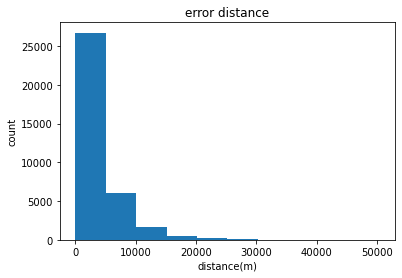

In [44]:
distdiff_list=np.array(loc_diff_df['dist_diff'])
plt.hist(distdiff_list)

plt.title("error distance")
plt.xlabel("distance(m)")
plt.ylabel("count")
plt.show()

In [45]:
df = gpd.read_file(gpd.datasets.get_path('nybb')).to_crs(epsg=3857)


In [233]:
#台鐵
train=gpd.read_file('RAIL_1100406.SHP',encoding='utf8')
train.crs='EPSG:3826'
train= gpd.sjoin(train, taipei, how="inner")
train

,RAILID,RAILNAME,RAILTYPE,MDATE,SOURCE,DEFINITION,geometry,index_right,id,fid,COUNTYID,COUNTYCODE,COUNTYNAME,COUNTYENG
0,A0000000006,臺鐵縱貫線(北段),3,202001,0,1,"LINESTRING (312393.117 2771952.928, 312440.446...",0,9,9,A,63000,臺北市,Taipei City
1,A0000000007,None,3,202001,0,1,"LINESTRING (302860.759 2771016.466, 302901.985...",0,9,9,A,63000,臺北市,Taipei City
2,A0000000008,臺鐵縱貫線(北段),3,202001,0,1,"LINESTRING (299198.908 2768871.812, 299199.196...",0,9,9,A,63000,臺北市,Taipei City
3,A0000000009,臺鐵縱貫線(北段),3,202001,0,1,"LINESTRING (302860.759 2771016.466, 302870.702...",0,9,9,A,63000,臺北市,Taipei City
4,A0000000010,臺鐵縱貫線(北段),3,202001,0,1,"LINESTRING (312393.117 2771952.928, 312430.538...",0,9,9,A,63000,臺北市,Taipei City
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
449,F0000000435,臺鐵五堵貨場,2,202001,0,0,"LINESTRING (318294.225 2775196.172, 318197.849...",1,10,10,F,65000,新北市,New Taipei City
450,F0000000436,臺鐵五堵貨場,2,202001,0,0,"LINESTRING (318104.858 2775102.452, 318141.225...",1,10,10,F,65000,新北市,New Taipei City
451,F0000000437,臺鐵五堵貨場,2,202001,0,0,"LINESTRING (318062.385 2775075.413, 317981.141...",1,10,10,F,65000,新北市,New Taipei City
452,F0000000438,臺鐵平溪線,2,202001,0,0,"LINESTRING (322915.903 2768571.735, 322935.366...",1,10,10,F,65000,新北市,New Taipei City


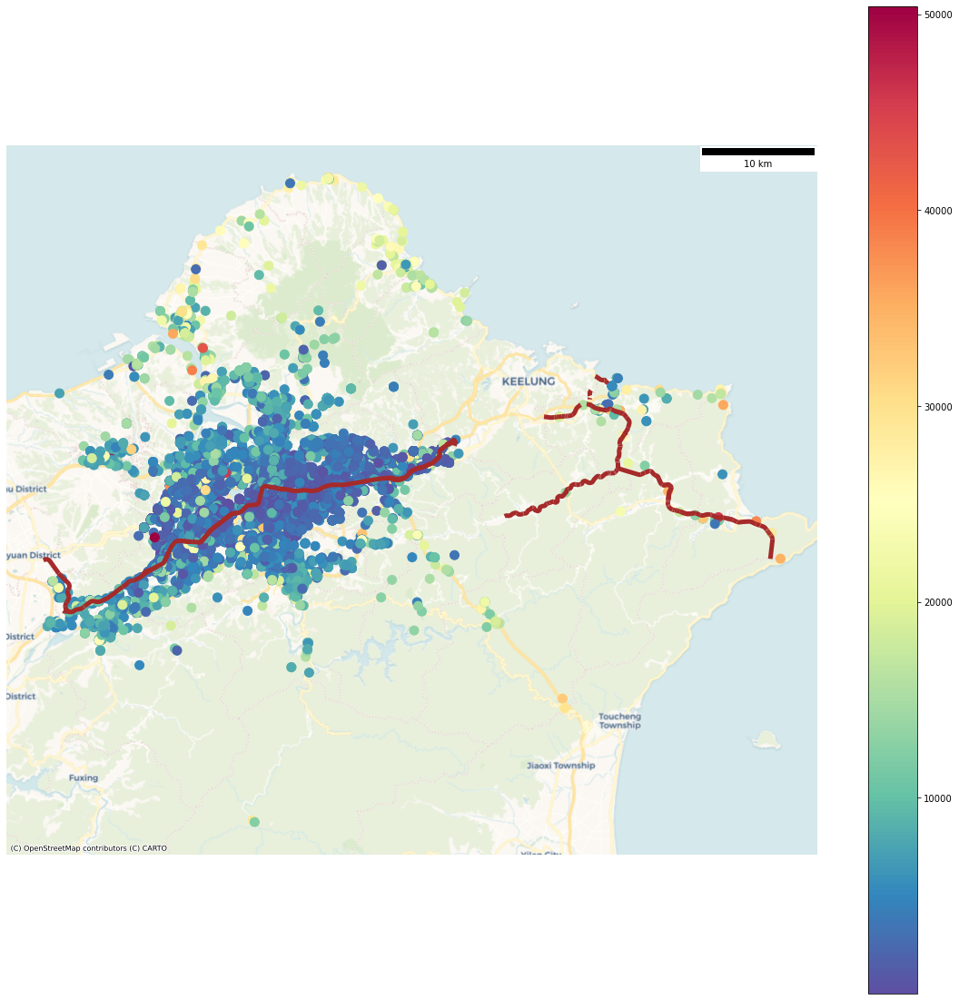

In [298]:
f, ax = plt.subplots(1, figsize=(20,20))

loc_diff_df.plot(ax=ax,figsize=(35,35), cmap='Spectral_r', marker='o', markersize=100,column='dist_diff',legend=True)
#new_df_id_sort_adjust.iloc[19:20].plot( ax=ax,  color='red', markersize=500)
train.plot( ax=ax,color="brown" ,linewidth=5, marker='-.')

#Socio_economic_database_POI.plot()
cx.add_basemap(ax=ax, crs='EPSG:3826', source=cx.providers.CartoDB.Voyager)
ax.add_artist(ScaleBar(1))

ax.set_axis_off()

plt.show()

In [42]:
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredSizeBar


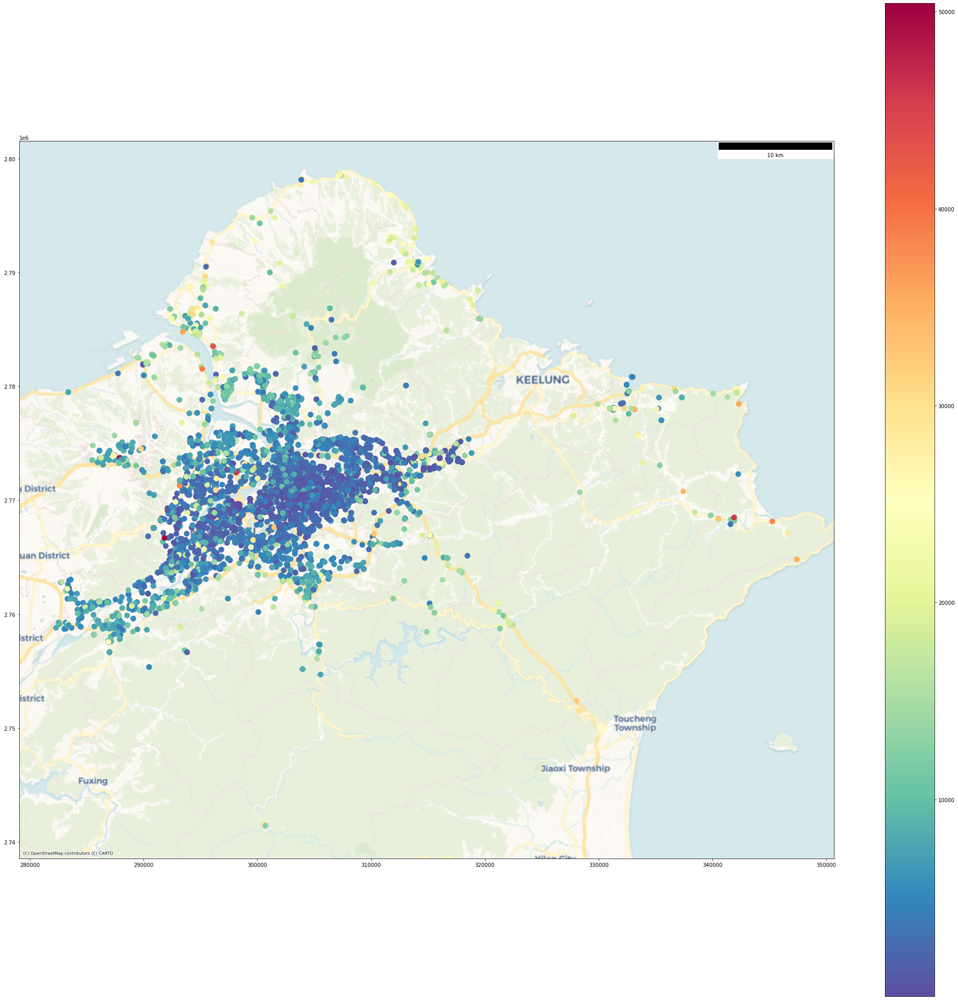

In [297]:
f, ax = plt.subplots(1, figsize=(35,35))
loc_diff_df.plot(ax=ax, cmap='Spectral_r', marker='o', markersize=100,column='dist_diff',legend=True)#figsize=(60,60)

#cx.add_basemap(ax=ac,crs='EPSG:3826')
cx.add_basemap(ax=ax, crs='EPSG:3826', source=cx.providers.CartoDB.Voyager)
#cx.add_basemap(ax, crs=db.crs.to_string()) source=cx.providers.CartoDB.Voyager
ax.add_artist(ScaleBar(1))


dir(px.colors.diverging.Spectral)

In [47]:
loc_diff_df

,geom_x_median_pred,geom_y_median_pred,geom_x_median_true,geom_y_median_true,hr_sin,date_part_sin,geom_x_median,geom_y_median,geometry,geometry2,geometry3,dist_diff,device_id
0,285397.12500,2765781.50,283137,2.75872e+06,-0.631088,-0.781831,283136,2.75875e+06,POINT (283136.425 2758752.709),POINT (285397.125 2765781.500),POINT (283137.335 2758722.928),7411.483931,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...
1,285420.46875,2765800.25,283125,2.75875e+06,0.136167,0.781831,283137,2.75872e+06,POINT (283137.335 2758722.928),POINT (285420.469 2765800.250),POINT (283125.148 2758750.965),7413.562483,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...
2,285235.21875,2765748.50,283139,2.75873e+06,-2.44929e-16,0,283125,2.75875e+06,POINT (283125.148 2758750.965),POINT (285235.219 2765748.500),POINT (283139.023 2758726.842),7327.873192,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...
3,285375.65625,2765787.00,283145,2.75873e+06,-0.519584,0,283139,2.75873e+06,POINT (283139.023 2758726.842),POINT (285375.656 2765787.000),POINT (283144.651 2758725.725),7405.334923,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...
4,285267.25000,2765756.25,283147,2.75872e+06,-0.136167,0,283145,2.75873e+06,POINT (283144.651 2758725.725),POINT (285267.250 2765756.250),POINT (283147.418 2758721.578),7347.128166,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...
...,...,...,...,...,...,...,...,...,...,...,...,...,...
35285,308928.18750,2772279.50,308912,2.76419e+06,0.136167,0.781831,308947,2.76431e+06,POINT (308947.152 2764306.436),POINT (308928.188 2772279.500),POINT (308912.151 2764193.613),8085.903273,XApeleBVvjgCasCmXscXyuvmVuZhO566c2JY9gdvJo9aR6...
35286,308939.50000,2772281.50,307690,2.76496e+06,0.136167,0.781831,308912,2.76419e+06,POINT (308912.151 2764193.613),POINT (308939.500 2772281.500),POINT (307689.669 2764963.789),7423.676108,XApeleBVvjgCasCmXscXyuvmVuZhO566c2JY9gdvJo9aR6...
35287,308039.37500,2772030.75,304303,2.76909e+06,0.398401,0.781831,307690,2.76496e+06,POINT (307689.669 2764963.789),POINT (308039.375 2772030.750),POINT (304303.469 2769090.326),4754.270086,XApeleBVvjgCasCmXscXyuvmVuZhO566c2JY9gdvJo9aR6...
35288,303062.81250,2770660.50,302876,2.76959e+06,-0.398401,0.433884,302876,2.76959e+06,POINT (302875.848 2769593.060),POINT (303062.812 2770660.500),POINT (302875.552 2769591.286),1085.488008,rjaxzN4PEVgWkoAscIMFAaReqS19gPSj+1E5t/9mN/o1nd...


In [46]:
import plotly.express as px
token='pk.eyJ1IjoibG9neXVhbiIsImEiOiJjaXcwc3JncmQwMDJqMnRta3p5OWR6YzhqIn0.YnGxzFD8-DhNUntfOpdhtg'
px.set_mapbox_access_token(token)
df =loc_diff_df.loc[loc_diff_df['dist_diff']>0].to_crs('EPSG:4326')
fig = px.scatter_mapbox(df, lat=df.geometry.y, lon=df.geometry.x,     color="dist_diff", size="dist_diff",
                  color_continuous_scale=px.colors.diverging.Spectral_r, size_max=15, zoom=10)
fig.show()




In [46]:
right_df=pd.DataFrame(landAllX[:,3,:],columns=landlist_x[1:])
#含有device_id_x欄位
#device_id_right_df=pd.DataFrame(AllX_device_id[:,3,:],columns=['device_id_x','geom_x_median','geom_y_median','date_part_sin','hr_sin'])
left_df=pd.DataFrame(landAllY,columns=landlist_x[-25:-5])
#把AllX拿去做預測
pred = pd.DataFrame(land_model.predict(landAllX.astype('float64')),columns=landlist_x[-25:-5])
#把以上四個df串起來
land_diff_df = pd.concat([pred,left_df,right_df],axis=1)

land_diff_df[['geom_y_median']] *= lstm_NOT_home_cyclic["geom_y"].median()
land_diff_df[['geom_x_median']] *=  lstm_NOT_home_cyclic["geom_x"].median()
land_diff_df = gpd.GeoDataFrame(land_diff_df,geometry=gpd.points_from_xy(land_diff_df.geom_x_median, land_diff_df.geom_y_median) )

land_diff_df.crs='EPSG:3826'

land_diff_df['device_id']=land_idlist
land_diff_df

,工商業總家數,農、林、漁、牧業,礦業及土石採取業,製造業,電力及燃氣供應業,用水供應及污染整治業,營造業,批發及零售業,運輸及倉儲業,住宿及餐飲業,...,醫療保健及社會工作服務業,藝術、娛樂及休閒服務業,其他服務業,date_part_sin_x,hr_sin,hr_cos,geom_x_median,geom_y_median,geometry,device_id
0,9.925451,0.0,0.0,0.919380,0.0,0.0,1.043558,4.936814,0.0,0.000000,...,0,0,1,-0.781831,-0.631088,-0.775711,283136,2.75875e+06,POINT (283136.425 2758752.709),+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...
1,9.988491,0.0,0.0,0.885405,0.0,0.0,1.053275,4.977801,0.0,0.000000,...,0,0,1,0.781831,0.136167,-0.990686,283137,2.75872e+06,POINT (283137.335 2758722.928),+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...
2,9.934994,0.0,0.0,0.907104,0.0,0.0,1.035988,5.012715,0.0,0.000000,...,0,0,1,0,-2.44929e-16,1,283125,2.75875e+06,POINT (283125.148 2758750.965),+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...
3,9.974476,0.0,0.0,0.901598,0.0,0.0,1.045168,4.991157,0.0,0.000000,...,0,0,1,0,-0.519584,0.854419,283139,2.75873e+06,POINT (283139.023 2758726.842),+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...
4,9.986324,0.0,0.0,0.892847,0.0,0.0,1.063520,4.953688,0.0,0.000000,...,0,0,1,0,-0.136167,-0.990686,283145,2.75873e+06,POINT (283144.651 2758725.725),+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35285,2.905140,0.0,0.0,0.000000,0.0,0.0,0.847143,2.108351,0.0,0.000000,...,0,0,0,0.781831,0.136167,-0.990686,308947,2.76431e+06,POINT (308947.152 2764306.436),XApeleBVvjgCasCmXscXyuvmVuZhO566c2JY9gdvJo9aR6...
35286,3.182714,0.0,0.0,0.000000,0.0,0.0,0.000000,2.069581,0.0,0.000000,...,0,0,0,0.781831,0.136167,-0.990686,308912,2.76419e+06,POINT (308912.151 2764193.613),XApeleBVvjgCasCmXscXyuvmVuZhO566c2JY9gdvJo9aR6...
35287,2.105081,0.0,0.0,0.000000,0.0,0.0,0.000000,1.106483,0.0,0.729226,...,0,0,0,0.781831,0.398401,-0.917211,307690,2.76496e+06,POINT (307689.669 2764963.789),XApeleBVvjgCasCmXscXyuvmVuZhO566c2JY9gdvJo9aR6...
35288,9.047001,0.0,0.0,0.800867,0.0,0.0,0.001481,2.054291,0.0,0.734942,...,0,1,0,0.433884,-0.398401,-0.917211,302876,2.76959e+06,POINT (302875.848 2769593.060),rjaxzN4PEVgWkoAscIMFAaReqS19gPSj+1E5t/9mN/o1nd...


In [47]:
sql='''
SELECT * FROM chi."Socio_economic_database_POI" WHERE "COUNTY" IN ('臺北市','新北市')
'''
Socio_economic_database_POI=gpd.GeoDataFrame.from_postgis(sql, engine, geom_col='geom' )


Socio_economic_database_POI.sindex

In [48]:
loc_diff_df.describe(percentiles=[0.25]).dist_diff

count    35290.000000
mean      3854.047413
std       3868.335267
min          4.702106
25%       1451.780637
50%       2657.938433
max      50427.466900
Name: dist_diff, dtype: float64

In [184]:
Socio_economic_database_POI

,CODEBASE,TOWN,COUNTY,醫療院所家數,老人安養機構家數,社區照顧關懷據點家數,兒童福利服務機構家數,婦幼福利服務機構家數,老人安養、養護、長期照護機構家數,居家服務支援中心家數,...,不動產業,專業、科學及技術服務業,支援服務業,公共行政及國防；強制性社會安全,教育服務業,醫療保健及社會工作服務業,藝術、娛樂及休閒服務業,其他服務業,資料時間,geom
0,A6301-0001-00,松山區,臺北市,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,108Y,"POLYGON ((121.55629 25.07494, 121.55741 25.074..."
1,A6301-0002-00,松山區,臺北市,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,108Y,"POLYGON ((121.56292 25.07155, 121.56320 25.071..."
2,A6301-0003-00,松山區,臺北市,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,2,108Y,"POLYGON ((121.55699 25.07261, 121.55697 25.072..."
3,A6301-0004-00,松山區,臺北市,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,108Y,"POLYGON ((121.55222 25.07344, 121.55541 25.073..."
4,A6301-0005-00,松山區,臺北市,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,108Y,"POLYGON ((121.55106 25.07226, 121.55152 25.072..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28762,A6529-0022-00,烏來區,新北市,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,108Y,"POLYGON ((121.44838 24.78437, 121.44862 24.784..."
28763,A6529-0023-00,烏來區,新北市,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,108Y,"POLYGON ((121.56575 24.80020, 121.56584 24.799..."
28764,A6529-0003-00,烏來區,新北市,1,0,1,0,0,0,0,...,0,0,0,0,0,0,0,1,108Y,"POLYGON ((121.54424 24.87550, 121.54425 24.875..."
28765,A6529-0004-00,烏來區,新北市,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,108Y,"POLYGON ((121.55155 24.88979, 121.55161 24.889..."


# --------------------------------------------------ppt---------------------------------------

In [49]:
#取500公尺以下的
# geometry3 正確的 geometry2 單一座標預測的
loc_diff_df_sort=loc_diff_df.sort_values(by=['dist_diff'])

big_difference_dist_diff=loc_diff_df_sort[loc_diff_df['dist_diff'] <= 500]#.copy()

big_difference_dist_diff

C:\Users\GIS519\Anaconda3\envs\python38\lib\site-packages\geopandas\geodataframe.py:828: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  result = super(GeoDataFrame, self).__getitem__(key)


,geom_x_median_pred,geom_y_median_pred,geom_x_median_true,geom_y_median_true,hr_sin,date_part_sin,geom_x_median,geom_y_median,geometry,geometry2,geometry3,dist_diff,device_id
5258,300486.65625,2769760.75,300487,2.76977e+06,-0.997669,-0.974928,300502,2.76976e+06,POINT (300502.141 2769764.209),POINT (300486.656 2769760.750),POINT (300487.453 2769765.384),4.702106,m4ecoLjWmrRUIRalaMYkxZOY7BB5H6eJYGWIHRVQ7CKxyJ...
23354,300459.68750,2769755.25,300454,2.76977e+06,-0.136167,-0.781831,300477,2.76985e+06,POINT (300477.233 2769849.440),POINT (300459.688 2769755.250),POINT (300454.331 2769774.045),19.543766,9/AtohXtwEsDu5ITOlL81Qq2DArmE+Cu2rX0NdPiLjL0jF...
27424,298249.56250,2769165.75,298270,2.76915e+06,-0.887885,0,298270,2.76915e+06,POINT (298270.467 2769150.340),POINT (298249.562 2769165.750),POINT (298270.467 2769150.340),25.970364,gQcmt0vwrw9GYAkrdSm204zyKD6LSHdSkvHOmW/9lU7zqw...
27423,298242.50000,2769164.25,298270,2.76915e+06,-0.887885,0,298270,2.76915e+06,POINT (298270.467 2769150.340),POINT (298242.500 2769164.250),POINT (298270.467 2769150.340),31.235050,gQcmt0vwrw9GYAkrdSm204zyKD6LSHdSkvHOmW/9lU7zqw...
21842,300467.43750,2769750.25,300439,2.76977e+06,-0.398401,-0.781831,300439,2.76977e+06,POINT (300438.917 2769767.099),POINT (300467.438 2769750.250),POINT (300438.917 2769767.099),33.125610,ZbgWkjnc7OZ4/rekWTNdvcrH3ZZXl6CgD5jdAlstvTlRDt...
...,...,...,...,...,...,...,...,...,...,...,...,...,...
23343,304314.65625,2770755.75,304803,2.77066e+06,-0.979084,-0.781831,304804,2.77066e+06,POINT (304803.927 2770657.356),POINT (304314.656 2770755.750),POINT (304802.932 2770656.322),498.296095,9/AtohXtwEsDu5ITOlL81Qq2DArmE+Cu2rX0NdPiLjL0jF...
5100,297356.09375,2768932.75,297444,2.76942e+06,0.136167,0.433884,297445,2.76942e+06,POINT (297444.603 2769424.019),POINT (297356.094 2768932.750),POINT (297444.120 2769423.707),498.786262,m4ecoLjWmrRUIRalaMYkxZOY7BB5H6eJYGWIHRVQ7CKxyJ...
8656,300670.81250,2769800.00,300720,2.7693e+06,-0.887885,-0.974928,300715,2.76928e+06,POINT (300714.760 2769282.697),POINT (300670.812 2769800.000),POINT (300719.830 2769303.318),499.094983,+KlT/6WCQLy+rfEptMpvDHuMgznBkFvBDm7wt/Cy6N+9NR...
18568,303185.62500,2770457.50,303491,2.77006e+06,-0.631088,-0.974928,303491,2.77006e+06,POINT (303491.418 2770062.893),POINT (303185.625 2770457.500),POINT (303491.418 2770062.893),499.223203,XAl4PBxlWxaUCRmPo1j37I2KckpCELcBiqViGKiHEvT7HA...


In [50]:
import warnings
from tqdm.notebook import tqdm
import sys
from scipy.spatial import distance_matrix

import pandas as pd
from pandas.core.common import SettingWithCopyWarning


warnings.simplefilter(action="ignore", category=SettingWithCopyWarning)
    


from scipy.spatial import distance
land_columns=['工商業總家數','農、林、漁、牧業','礦業及土石採取業',
                                            '製造業','電力及燃氣供應業','用水供應及污染整治業','營造業',
                                            '批發及零售業','運輸及倉儲業','住宿及餐飲業','資訊及通訊傳播業',
                                                    '金融及保險業','不動產業','專業、科學及技術服務業','支援服務業',
                                                    '公共行政及國防；強制性社會安全','教育服務業','醫療保健及社會工作服務業',
                                                   '藝術、娛樂及休閒服務業','其他服務業']
with tqdm(total=len(big_difference_dist_diff), file=sys.stdout) as pbar:
    new_df  = pd.DataFrame()
    for i in range(len(big_difference_dist_diff)):
        pbar.set_description('processed: %d' % (1 + i))
        pbar.update(1)
        test_data_loc = big_difference_dist_diff.iloc[i:i+1,:]
        test_data_loc['geometry'] = test_data_loc.buffer(250)
        test_data_land = land_diff_df.iloc[i:i+1,0:20]
        xmin, ymin, xmax, ymax = test_data_loc.to_crs('EPSG:4326').total_bounds
        sql='''
        SELECT *
        FROM chi."Socio_economic_database_POI" 
        WHERE chi."Socio_economic_database_POI".geom && ST_MakeEnvelope({}, {}, {}, {} , 4326)
        '''.format(xmin, ymin, xmax, ymax)
        %time candidates=gpd.GeoDataFrame.from_postgis(sql, engine, geom_col='geom',crs='EPSG:4326').to_crs('EPSG:3826')
        similiarity=[]
        b=test_data_land[land_columns].iloc[0].values
        x=b.reshape(1,20)
        y =candidates[land_columns].values.astype('float') 
        %time candidates['similiarity'] =distance_matrix(x,y).reshape(-1)
        test_data_loc['adjust']= candidates.sort_values('similiarity').iloc[0]['geom'].centroid
        test_data_loc['adjust'] = test_data_loc['adjust'].astype('geometry')
        test_data_loc['dist_diff_adjust'] =  test_data_loc['adjust'].distance(test_data_loc['geometry3'])
        new_df = new_df.append(test_data_loc.copy(),ignore_index=True)


  0%|          | 0/1934 [00:00<?, ?it/s]

Wall time: 157 ms
Wall time: 0 ns
Wall time: 152 ms
Wall time: 0 ns
Wall time: 182 ms
Wall time: 997 µs
Wall time: 188 ms
Wall time: 0 ns
Wall time: 186 ms
Wall time: 997 µs
Wall time: 164 ms
Wall time: 998 µs
Wall time: 161 ms
Wall time: 997 µs
Wall time: 182 ms
Wall time: 0 ns
Wall time: 172 ms
Wall time: 0 ns
Wall time: 203 ms
Wall time: 0 ns
Wall time: 209 ms
Wall time: 0 ns
Wall time: 189 ms
Wall time: 1.02 ms
Wall time: 139 ms
Wall time: 0 ns
Wall time: 159 ms
Wall time: 998 µs
Wall time: 163 ms
Wall time: 0 ns
Wall time: 180 ms
Wall time: 0 ns
Wall time: 160 ms
Wall time: 997 µs
Wall time: 170 ms
Wall time: 0 ns
Wall time: 148 ms
Wall time: 0 ns
Wall time: 172 ms
Wall time: 998 µs
Wall time: 162 ms
Wall time: 997 µs
Wall time: 160 ms
Wall time: 0 ns
Wall time: 157 ms
Wall time: 0 ns
Wall time: 164 ms
Wall time: 0 ns
Wall time: 214 ms
Wall time: 0 ns
Wall time: 155 ms
Wall time: 0 ns
Wall time: 172 ms
Wall time: 997 µs
Wall time: 156 ms
Wall time: 1.02 ms
Wall time: 175 ms
Wall t

Wall time: 194 ms
Wall time: 974 µs
Wall time: 151 ms
Wall time: 0 ns
Wall time: 159 ms
Wall time: 997 µs
Wall time: 121 ms
Wall time: 994 µs
Wall time: 152 ms
Wall time: 0 ns
Wall time: 152 ms
Wall time: 997 µs
Wall time: 193 ms
Wall time: 993 µs
Wall time: 154 ms
Wall time: 997 µs
Wall time: 191 ms
Wall time: 998 µs
Wall time: 141 ms
Wall time: 978 µs
Wall time: 166 ms
Wall time: 0 ns
Wall time: 153 ms
Wall time: 0 ns
Wall time: 178 ms
Wall time: 966 µs
Wall time: 155 ms
Wall time: 0 ns
Wall time: 161 ms
Wall time: 0 ns
Wall time: 138 ms
Wall time: 1 ms
Wall time: 158 ms
Wall time: 998 µs
Wall time: 185 ms
Wall time: 998 µs
Wall time: 178 ms
Wall time: 997 µs
Wall time: 171 ms
Wall time: 0 ns
Wall time: 159 ms
Wall time: 998 µs
Wall time: 167 ms
Wall time: 985 µs
Wall time: 227 ms
Wall time: 998 µs
Wall time: 176 ms
Wall time: 0 ns
Wall time: 192 ms
Wall time: 0 ns
Wall time: 156 ms
Wall time: 997 µs
Wall time: 189 ms
Wall time: 1.02 ms
Wall time: 155 ms
Wall time: 0 ns
Wall time: 13

Wall time: 114 ms
Wall time: 0 ns
Wall time: 159 ms
Wall time: 0 ns
Wall time: 187 ms
Wall time: 998 µs
Wall time: 141 ms
Wall time: 998 µs
Wall time: 146 ms
Wall time: 0 ns
Wall time: 160 ms
Wall time: 0 ns
Wall time: 163 ms
Wall time: 0 ns
Wall time: 146 ms
Wall time: 0 ns
Wall time: 161 ms
Wall time: 0 ns
Wall time: 161 ms
Wall time: 997 µs
Wall time: 183 ms
Wall time: 0 ns
Wall time: 163 ms
Wall time: 997 µs
Wall time: 123 ms
Wall time: 0 ns
Wall time: 160 ms
Wall time: 998 µs
Wall time: 180 ms
Wall time: 0 ns
Wall time: 172 ms
Wall time: 0 ns
Wall time: 118 ms
Wall time: 0 ns
Wall time: 150 ms
Wall time: 997 µs
Wall time: 146 ms
Wall time: 998 µs
Wall time: 119 ms
Wall time: 0 ns
Wall time: 131 ms
Wall time: 0 ns
Wall time: 120 ms
Wall time: 995 µs
Wall time: 151 ms
Wall time: 0 ns
Wall time: 196 ms
Wall time: 0 ns
Wall time: 158 ms
Wall time: 999 µs
Wall time: 124 ms
Wall time: 0 ns
Wall time: 159 ms
Wall time: 0 ns
Wall time: 145 ms
Wall time: 0 ns
Wall time: 152 ms
Wall time: 0

Wall time: 176 ms
Wall time: 0 ns
Wall time: 144 ms
Wall time: 0 ns
Wall time: 162 ms
Wall time: 0 ns
Wall time: 126 ms
Wall time: 0 ns
Wall time: 198 ms
Wall time: 0 ns
Wall time: 230 ms
Wall time: 997 µs
Wall time: 214 ms
Wall time: 0 ns
Wall time: 180 ms
Wall time: 0 ns
Wall time: 132 ms
Wall time: 997 µs
Wall time: 155 ms
Wall time: 1 ms
Wall time: 154 ms
Wall time: 997 µs
Wall time: 124 ms
Wall time: 975 µs
Wall time: 161 ms
Wall time: 997 µs
Wall time: 152 ms
Wall time: 0 ns
Wall time: 187 ms
Wall time: 0 ns
Wall time: 183 ms
Wall time: 0 ns
Wall time: 147 ms
Wall time: 999 µs
Wall time: 154 ms
Wall time: 0 ns
Wall time: 149 ms
Wall time: 0 ns
Wall time: 234 ms
Wall time: 997 µs
Wall time: 191 ms
Wall time: 0 ns
Wall time: 178 ms
Wall time: 1 ms
Wall time: 172 ms
Wall time: 993 µs
Wall time: 146 ms
Wall time: 0 ns
Wall time: 161 ms
Wall time: 0 ns
Wall time: 203 ms
Wall time: 997 µs
Wall time: 214 ms
Wall time: 0 ns
Wall time: 167 ms
Wall time: 1.01 ms
Wall time: 154 ms
Wall time

Wall time: 167 ms
Wall time: 998 µs
Wall time: 159 ms
Wall time: 997 µs
Wall time: 122 ms
Wall time: 0 ns
Wall time: 167 ms
Wall time: 0 ns
Wall time: 153 ms
Wall time: 0 ns
Wall time: 156 ms
Wall time: 0 ns
Wall time: 162 ms
Wall time: 997 µs
Wall time: 152 ms
Wall time: 0 ns
Wall time: 155 ms
Wall time: 0 ns
Wall time: 167 ms
Wall time: 997 µs
Wall time: 148 ms
Wall time: 997 µs
Wall time: 127 ms
Wall time: 0 ns
Wall time: 159 ms
Wall time: 0 ns
Wall time: 146 ms
Wall time: 0 ns
Wall time: 123 ms
Wall time: 0 ns
Wall time: 220 ms
Wall time: 1.02 ms
Wall time: 196 ms
Wall time: 0 ns
Wall time: 161 ms
Wall time: 0 ns
Wall time: 156 ms
Wall time: 997 µs
Wall time: 172 ms
Wall time: 0 ns
Wall time: 160 ms
Wall time: 1.01 ms
Wall time: 130 ms
Wall time: 0 ns
Wall time: 167 ms
Wall time: 0 ns
Wall time: 158 ms
Wall time: 0 ns
Wall time: 163 ms
Wall time: 0 ns
Wall time: 221 ms
Wall time: 0 ns
Wall time: 206 ms
Wall time: 0 ns
Wall time: 154 ms
Wall time: 998 µs
Wall time: 148 ms
Wall time:

Wall time: 155 ms
Wall time: 0 ns
Wall time: 158 ms
Wall time: 0 ns
Wall time: 211 ms
Wall time: 0 ns
Wall time: 196 ms
Wall time: 0 ns
Wall time: 188 ms
Wall time: 998 µs
Wall time: 156 ms
Wall time: 997 µs
Wall time: 160 ms
Wall time: 0 ns
Wall time: 172 ms
Wall time: 995 µs
Wall time: 172 ms
Wall time: 0 ns
Wall time: 162 ms
Wall time: 997 µs
Wall time: 160 ms
Wall time: 0 ns
Wall time: 158 ms
Wall time: 997 µs
Wall time: 194 ms
Wall time: 0 ns
Wall time: 175 ms
Wall time: 0 ns
Wall time: 172 ms
Wall time: 0 ns
Wall time: 163 ms
Wall time: 0 ns
Wall time: 152 ms
Wall time: 0 ns
Wall time: 178 ms
Wall time: 0 ns
Wall time: 187 ms
Wall time: 0 ns
Wall time: 181 ms
Wall time: 998 µs
Wall time: 164 ms
Wall time: 998 µs
Wall time: 156 ms
Wall time: 997 µs
Wall time: 152 ms
Wall time: 0 ns
Wall time: 189 ms
Wall time: 0 ns
Wall time: 172 ms
Wall time: 0 ns
Wall time: 154 ms
Wall time: 0 ns
Wall time: 155 ms
Wall time: 997 µs
Wall time: 161 ms
Wall time: 997 µs
Wall time: 206 ms
Wall time:

Wall time: 135 ms
Wall time: 0 ns
Wall time: 162 ms
Wall time: 0 ns
Wall time: 188 ms
Wall time: 0 ns
Wall time: 179 ms
Wall time: 0 ns
Wall time: 165 ms
Wall time: 0 ns
Wall time: 143 ms
Wall time: 973 µs
Wall time: 137 ms
Wall time: 997 µs
Wall time: 159 ms
Wall time: 0 ns
Wall time: 136 ms
Wall time: 0 ns
Wall time: 165 ms
Wall time: 0 ns
Wall time: 125 ms
Wall time: 998 µs
Wall time: 237 ms
Wall time: 0 ns
Wall time: 189 ms
Wall time: 0 ns
Wall time: 165 ms
Wall time: 998 µs
Wall time: 153 ms
Wall time: 0 ns
Wall time: 157 ms
Wall time: 997 µs
Wall time: 162 ms
Wall time: 0 ns
Wall time: 180 ms
Wall time: 0 ns
Wall time: 194 ms
Wall time: 0 ns
Wall time: 154 ms
Wall time: 0 ns
Wall time: 154 ms
Wall time: 997 µs
Wall time: 190 ms
Wall time: 996 µs
Wall time: 179 ms
Wall time: 0 ns
Wall time: 183 ms
Wall time: 0 ns
Wall time: 184 ms
Wall time: 998 µs
Wall time: 164 ms
Wall time: 0 ns
Wall time: 160 ms
Wall time: 996 µs
Wall time: 139 ms
Wall time: 1.02 ms
Wall time: 179 ms
Wall time

Wall time: 160 ms
Wall time: 0 ns
Wall time: 310 ms
Wall time: 997 µs
Wall time: 173 ms
Wall time: 997 µs
Wall time: 160 ms
Wall time: 0 ns
Wall time: 155 ms
Wall time: 0 ns
Wall time: 182 ms
Wall time: 997 µs
Wall time: 183 ms
Wall time: 0 ns
Wall time: 152 ms
Wall time: 0 ns
Wall time: 159 ms
Wall time: 0 ns
Wall time: 189 ms
Wall time: 1.02 ms
Wall time: 164 ms
Wall time: 997 µs
Wall time: 196 ms
Wall time: 997 µs
Wall time: 169 ms
Wall time: 0 ns
Wall time: 156 ms
Wall time: 1.02 ms
Wall time: 166 ms
Wall time: 1.02 ms
Wall time: 157 ms
Wall time: 998 µs
Wall time: 164 ms
Wall time: 0 ns
Wall time: 168 ms
Wall time: 997 µs
Wall time: 175 ms
Wall time: 0 ns
Wall time: 154 ms
Wall time: 996 µs
Wall time: 179 ms
Wall time: 1.01 ms
Wall time: 164 ms
Wall time: 983 µs
Wall time: 134 ms
Wall time: 0 ns
Wall time: 154 ms
Wall time: 0 ns
Wall time: 177 ms
Wall time: 999 µs
Wall time: 186 ms
Wall time: 0 ns
Wall time: 167 ms
Wall time: 997 µs
Wall time: 163 ms
Wall time: 997 µs
Wall time: 1

Wall time: 152 ms
Wall time: 997 µs
Wall time: 118 ms
Wall time: 0 ns
Wall time: 166 ms
Wall time: 998 µs
Wall time: 154 ms
Wall time: 0 ns
Wall time: 163 ms
Wall time: 0 ns
Wall time: 157 ms
Wall time: 0 ns
Wall time: 189 ms
Wall time: 997 µs
Wall time: 184 ms
Wall time: 1.02 ms
Wall time: 145 ms
Wall time: 0 ns
Wall time: 155 ms
Wall time: 0 ns
Wall time: 180 ms
Wall time: 997 µs
Wall time: 198 ms
Wall time: 0 ns
Wall time: 187 ms
Wall time: 0 ns
Wall time: 185 ms
Wall time: 0 ns
Wall time: 131 ms
Wall time: 992 µs
Wall time: 139 ms
Wall time: 0 ns
Wall time: 201 ms
Wall time: 0 ns
Wall time: 193 ms
Wall time: 0 ns
Wall time: 168 ms
Wall time: 0 ns
Wall time: 147 ms
Wall time: 0 ns
Wall time: 164 ms
Wall time: 0 ns
Wall time: 156 ms
Wall time: 0 ns
Wall time: 152 ms
Wall time: 0 ns
Wall time: 182 ms
Wall time: 0 ns
Wall time: 135 ms
Wall time: 1.01 ms
Wall time: 123 ms
Wall time: 0 ns
Wall time: 142 ms
Wall time: 0 ns
Wall time: 164 ms
Wall time: 0 ns
Wall time: 156 ms
Wall time: 0 n

In [54]:
new_df

,geom_x_median_pred,geom_y_median_pred,geom_x_median_true,geom_y_median_true,hr_sin,date_part_sin,geom_x_median,geom_y_median,geometry,geometry2,geometry3,dist_diff,device_id,adjust,dist_diff_adjust
0,300486.65625,2769760.75,300487,2.76977e+06,-0.997669,-0.974928,300502,2.76976e+06,"POLYGON ((300752.141 2769764.209, 300750.937 2...",POINT (300486.656 2769760.750),POINT (300487.453 2769765.384),4.702106,m4ecoLjWmrRUIRalaMYkxZOY7BB5H6eJYGWIHRVQ7CKxyJ...,POINT (300445.628 2769856.686),100.426535
1,300459.68750,2769755.25,300454,2.76977e+06,-0.136167,-0.781831,300477,2.76985e+06,"POLYGON ((300727.233 2769849.440, 300726.029 2...",POINT (300459.688 2769755.250),POINT (300454.331 2769774.045),19.543766,9/AtohXtwEsDu5ITOlL81Qq2DArmE+Cu2rX0NdPiLjL0jF...,POINT (300445.628 2769856.686),83.097827
2,298249.56250,2769165.75,298270,2.76915e+06,-0.887885,0,298270,2.76915e+06,"POLYGON ((298520.467 2769150.340, 298519.263 2...",POINT (298249.562 2769165.750),POINT (298270.467 2769150.340),25.970364,gQcmt0vwrw9GYAkrdSm204zyKD6LSHdSkvHOmW/9lU7zqw...,POINT (298117.206 2769351.403),252.814359
3,298242.50000,2769164.25,298270,2.76915e+06,-0.887885,0,298270,2.76915e+06,"POLYGON ((298520.467 2769150.340, 298519.263 2...",POINT (298242.500 2769164.250),POINT (298270.467 2769150.340),31.235050,gQcmt0vwrw9GYAkrdSm204zyKD6LSHdSkvHOmW/9lU7zqw...,POINT (298117.206 2769351.403),252.814359
4,300467.43750,2769750.25,300439,2.76977e+06,-0.398401,-0.781831,300439,2.76977e+06,"POLYGON ((300688.917 2769767.099, 300687.713 2...",POINT (300467.438 2769750.250),POINT (300438.917 2769767.099),33.125610,ZbgWkjnc7OZ4/rekWTNdvcrH3ZZXl6CgD5jdAlstvTlRDt...,POINT (300445.628 2769856.686),89.838319
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1929,304314.65625,2770755.75,304803,2.77066e+06,-0.979084,-0.781831,304804,2.77066e+06,"POLYGON ((305053.927 2770657.356, 305052.723 2...",POINT (304314.656 2770755.750),POINT (304802.932 2770656.322),498.296095,9/AtohXtwEsDu5ITOlL81Qq2DArmE+Cu2rX0NdPiLjL0jF...,POINT (304688.295 2770715.187),128.867125
1930,297356.09375,2768932.75,297444,2.76942e+06,0.136167,0.433884,297445,2.76942e+06,"POLYGON ((297694.603 2769424.019, 297693.399 2...",POINT (297356.094 2768932.750),POINT (297444.120 2769423.707),498.786262,m4ecoLjWmrRUIRalaMYkxZOY7BB5H6eJYGWIHRVQ7CKxyJ...,POINT (297290.871 2769228.337),248.303067
1931,300670.81250,2769800.00,300720,2.7693e+06,-0.887885,-0.974928,300715,2.76928e+06,"POLYGON ((300964.760 2769282.697, 300963.556 2...",POINT (300670.812 2769800.000),POINT (300719.830 2769303.318),499.094983,+KlT/6WCQLy+rfEptMpvDHuMgznBkFvBDm7wt/Cy6N+9NR...,POINT (300698.272 2769301.526),21.632161
1932,303185.62500,2770457.50,303491,2.77006e+06,-0.631088,-0.974928,303491,2.77006e+06,"POLYGON ((303741.418 2770062.893, 303740.214 2...",POINT (303185.625 2770457.500),POINT (303491.418 2770062.893),499.223203,XAl4PBxlWxaUCRmPo1j37I2KckpCELcBiqViGKiHEvT7HA...,POINT (303344.215 2769808.999),293.480886


In [55]:
new_df[['dist_diff','dist_diff_adjust']].mean()

dist_diff           339.709926
dist_diff_adjust    275.681948
dtype: float64

In [145]:
new_df_id_sort=new_df.sort_values(by=['dist_diff_adjust'])
new_df_id_sort_1=new_df_id_sort[new_df_id_sort['device_id']=='Fxmw/S9RD3w/SGZ2nnHRy8YrS0qpNknU4wTi7eHfzejcDgJSflaPuM/QffA6lrjj']
#new_df_id_sort_1=new_df_id_sort[new_df_id_sort['device_id']=='tPZF+rmtyNX/4G6rVJCJtDWhyQk5BkSrITy2u2pBz6+X43IXWDgUv9Xr2PLHGoH8']
new_df_id_sort_1
print(new_df_id_sort['device_id'].values[0:300])

['+KlT/6WCQLy+rfEptMpvDHuMgznBkFvBDm7wt/Cy6N+9NRpwEUPtdUd69EQLEVGn'
 '+KlT/6WCQLy+rfEptMpvDHuMgznBkFvBDm7wt/Cy6N+9NRpwEUPtdUd69EQLEVGn'
 '+KlT/6WCQLy+rfEptMpvDHuMgznBkFvBDm7wt/Cy6N+9NRpwEUPtdUd69EQLEVGn'
 'Fxmw/S9RD3w/SGZ2nnHRy8YrS0qpNknU4wTi7eHfzejcDgJSflaPuM/QffA6lrjj'
 'Fxmw/S9RD3w/SGZ2nnHRy8YrS0qpNknU4wTi7eHfzejcDgJSflaPuM/QffA6lrjj'
 'Fxmw/S9RD3w/SGZ2nnHRy8YrS0qpNknU4wTi7eHfzejcDgJSflaPuM/QffA6lrjj'
 'Fxmw/S9RD3w/SGZ2nnHRy8YrS0qpNknU4wTi7eHfzejcDgJSflaPuM/QffA6lrjj'
 'Fxmw/S9RD3w/SGZ2nnHRy8YrS0qpNknU4wTi7eHfzejcDgJSflaPuM/QffA6lrjj'
 'Fxmw/S9RD3w/SGZ2nnHRy8YrS0qpNknU4wTi7eHfzejcDgJSflaPuM/QffA6lrjj'
 'Fxmw/S9RD3w/SGZ2nnHRy8YrS0qpNknU4wTi7eHfzejcDgJSflaPuM/QffA6lrjj'
 'Fxmw/S9RD3w/SGZ2nnHRy8YrS0qpNknU4wTi7eHfzejcDgJSflaPuM/QffA6lrjj'
 'Fxmw/S9RD3w/SGZ2nnHRy8YrS0qpNknU4wTi7eHfzejcDgJSflaPuM/QffA6lrjj'
 'Fxmw/S9RD3w/SGZ2nnHRy8YrS0qpNknU4wTi7eHfzejcDgJSflaPuM/QffA6lrjj'
 'Fxmw/S9RD3w/SGZ2nnHRy8YrS0qpNknU4wTi7eHfzejcDgJSflaPuM/QffA6lrjj'
 'Fxmw/S9RD3w/SGZ2nnHRy8YrS0qpNknU4wTi7eHfzejcDg

In [171]:
new_df_id_sort_1=new_df_id_sort[new_df_id_sort['device_id']=='VyjiyOrcEOkDxgY0VfE2PQdKd8m2I/e9v0WQBzNAjCnUFbfQIBeWQcZ78i3iwW9H']
new_df_id_sort_1

,geom_x_median_pred,geom_y_median_pred,geom_x_median_true,geom_y_median_true,hr_sin,date_part_sin,geom_x_median,geom_y_median,geometry,geometry2,geometry3,dist_diff,device_id,adjust,dist_diff_adjust
1767,297834.46875,2769064.75,298100,2.76946e+06,0.136167,0.974928,298070,2.76945e+06,"POLYGON ((298320.393 2769454.906, 298319.189 2...",POINT (297834.469 2769064.750),POINT (298099.857 2769455.896),472.679371,VyjiyOrcEOkDxgY0VfE2PQdKd8m2I/e9v0WQBzNAjCnUFb...,POINT (298124.472 2769409.447),52.568113
1039,298349.90625,2769190.00,298162,2.76951e+06,0.136167,-0.974928,298162,2.76951e+06,"POLYGON ((298411.839 2769507.620, 298410.636 2...",POINT (298349.906 2769190.000),POINT (298161.839 2769507.620),369.122998,VyjiyOrcEOkDxgY0VfE2PQdKd8m2I/e9v0WQBzNAjCnUFb...,POINT (298130.723 2769567.264),67.272107
1042,298329.46875,2769176.50,298162,2.76951e+06,-0.887885,-0.974928,298160,2.76951e+06,"POLYGON ((298410.201 2769514.371, 298408.997 2...",POINT (298329.469 2769176.500),POINT (298162.248 2769506.293),369.764761,VyjiyOrcEOkDxgY0VfE2PQdKd8m2I/e9v0WQBzNAjCnUFb...,POINT (298130.723 2769567.264),68.638632
1045,298403.62500,2769205.75,298165,2.76949e+06,-0.81697,-0.974928,298221,2.76956e+06,"POLYGON ((298470.809 2769555.015, 298469.605 2...",POINT (298403.625 2769205.750),POINT (298165.334 2769489.578),370.595064,VyjiyOrcEOkDxgY0VfE2PQdKd8m2I/e9v0WQBzNAjCnUFb...,POINT (298130.723 2769567.264),85.047101
1149,298347.84375,2769189.75,298221,2.76956e+06,-0.81697,-0.974928,298221,2.76956e+06,"POLYGON ((298470.809 2769555.015, 298469.605 2...",POINT (298347.844 2769189.750),POINT (298220.809 2769555.015),386.724739,VyjiyOrcEOkDxgY0VfE2PQdKd8m2I/e9v0WQBzNAjCnUFb...,POINT (298130.723 2769567.264),90.914753
1621,297971.75000,2769093.25,298162,2.76951e+06,-0.942261,0.781831,298163,2.7695e+06,"POLYGON ((298412.562 2769503.081, 298411.358 2...",POINT (297971.750 2769093.250),POINT (298161.839 2769507.620),455.891108,VyjiyOrcEOkDxgY0VfE2PQdKd8m2I/e9v0WQBzNAjCnUFb...,POINT (298240.909 2769455.939),94.461269
1504,298001.59375,2769102.75,298159,2.76952e+06,0.631088,0.433884,298159,2.76952e+06,"POLYGON ((298409.168 2769521.014, 298407.965 2...",POINT (298001.594 2769102.750),POINT (298159.472 2769520.682),446.758401,VyjiyOrcEOkDxgY0VfE2PQdKd8m2I/e9v0WQBzNAjCnUFb...,POINT (298283.583 2769501.528),125.580151
1058,298370.75000,2769185.50,298258,2.76954e+06,-0.887885,-0.974928,298100,2.76946e+06,"POLYGON ((298349.857 2769455.896, 298348.653 2...",POINT (298370.750 2769185.500),POINT (298257.694 2769540.745),372.801334,VyjiyOrcEOkDxgY0VfE2PQdKd8m2I/e9v0WQBzNAjCnUFb...,POINT (298130.723 2769567.264),129.710337
1319,298322.34375,2769185.50,298318,2.76959e+06,0.136167,-0.974928,298162,2.76951e+06,"POLYGON ((298411.839 2769507.620, 298410.636 2...",POINT (298322.344 2769185.500),POINT (298317.759 2769592.132),406.657353,VyjiyOrcEOkDxgY0VfE2PQdKd8m2I/e9v0WQBzNAjCnUFb...,POINT (298450.436 2769525.093),148.651110
1735,297705.84375,2769025.25,298010,2.76938e+06,-0.942261,0.974928,298010,2.76938e+06,"POLYGON ((298259.587 2769383.913, 298258.383 2...",POINT (297705.844 2769025.250),POINT (298009.587 2769383.913),469.998851,VyjiyOrcEOkDxgY0VfE2PQdKd8m2I/e9v0WQBzNAjCnUFb...,POINT (298160.657 2769290.085),177.836330


In [172]:
new_df_id_sort_true=new_df_id_sort_1.rename(columns={'geometry':'geometry_polygon'})
new_df_id_sort_true=new_df_id_sort_true.rename(columns={'geometry3':'geometry'})
new_df_id_sort_pred=new_df_id_sort_1.rename(columns={'geometry':'geometry_polygon'})
new_df_id_sort_pred=new_df_id_sort_pred.rename(columns={'geometry2':'geometry'})
new_df_id_sort_adjust=new_df_id_sort_1.rename(columns={'geometry':'geometry_polygon'})
new_df_id_sort_adjust=new_df_id_sort_adjust.rename(columns={'adjust':'geometry'})

In [173]:
len(new_df_id_sort_1)

43

In [257]:
Socio_economic_database_POI

,CODEBASE,TOWN,COUNTY,醫療院所家數,老人安養機構家數,社區照顧關懷據點家數,兒童福利服務機構家數,婦幼福利服務機構家數,老人安養、養護、長期照護機構家數,居家服務支援中心家數,...,不動產業,專業、科學及技術服務業,支援服務業,公共行政及國防；強制性社會安全,教育服務業,醫療保健及社會工作服務業,藝術、娛樂及休閒服務業,其他服務業,資料時間,geom
0,A6301-0001-00,松山區,臺北市,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,108Y,"POLYGON ((121.55629 25.07494, 121.55741 25.074..."
1,A6301-0002-00,松山區,臺北市,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,108Y,"POLYGON ((121.56292 25.07155, 121.56320 25.071..."
2,A6301-0003-00,松山區,臺北市,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,2,108Y,"POLYGON ((121.55699 25.07261, 121.55697 25.072..."
3,A6301-0004-00,松山區,臺北市,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,108Y,"POLYGON ((121.55222 25.07344, 121.55541 25.073..."
4,A6301-0005-00,松山區,臺北市,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,108Y,"POLYGON ((121.55106 25.07226, 121.55152 25.072..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28762,A6529-0022-00,烏來區,新北市,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,108Y,"POLYGON ((121.44838 24.78437, 121.44862 24.784..."
28763,A6529-0023-00,烏來區,新北市,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,108Y,"POLYGON ((121.56575 24.80020, 121.56584 24.799..."
28764,A6529-0003-00,烏來區,新北市,1,0,1,0,0,0,0,...,0,0,0,0,0,0,0,1,108Y,"POLYGON ((121.54424 24.87550, 121.54425 24.875..."
28765,A6529-0004-00,烏來區,新北市,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,108Y,"POLYGON ((121.55155 24.88979, 121.55161 24.889..."


In [268]:
Socio_economic_database_POI_3826=Socio_economic_database_POI.to_crs(epsg=3826)
Socio_economic_database_POI_3826.crs

<Projected CRS: EPSG:3826>
Name: TWD97 / TM2 zone 121
Axis Info [cartesian]:
- X[east]: Easting (metre)
- Y[north]: Northing (metre)
Area of Use:
- name: Taiwan - 120°E to 122°E
- bounds: (119.99, 20.41, 122.06, 26.72)
Coordinate Operation:
- name: Taiwan 2-degree TM zone 121
- method: Transverse Mercator
Datum: Taiwan Datum 1997
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [192]:
new_df_id_sort_adjust.iloc[19:20]

,geom_x_median_pred,geom_y_median_pred,geom_x_median_true,geom_y_median_true,hr_sin,date_part_sin,geom_x_median,geom_y_median,geometry_polygon,geometry2,geometry3,dist_diff,device_id,geometry,dist_diff_adjust
1933,297913.625,2769078.0,298161,2.76951e+06,-0.81697,0.974928,298161,2.76951e+06,"POLYGON ((298411.321 2769511.606, 298410.117 2...",POINT (297913.625 2769078.000),POINT (298161.321 2769511.606),499.366977,VyjiyOrcEOkDxgY0VfE2PQdKd8m2I/e9v0WQBzNAjCnUFb...,POINT (298075.101 2769286.114),241.413388


(2769767.0, 2769043.0)

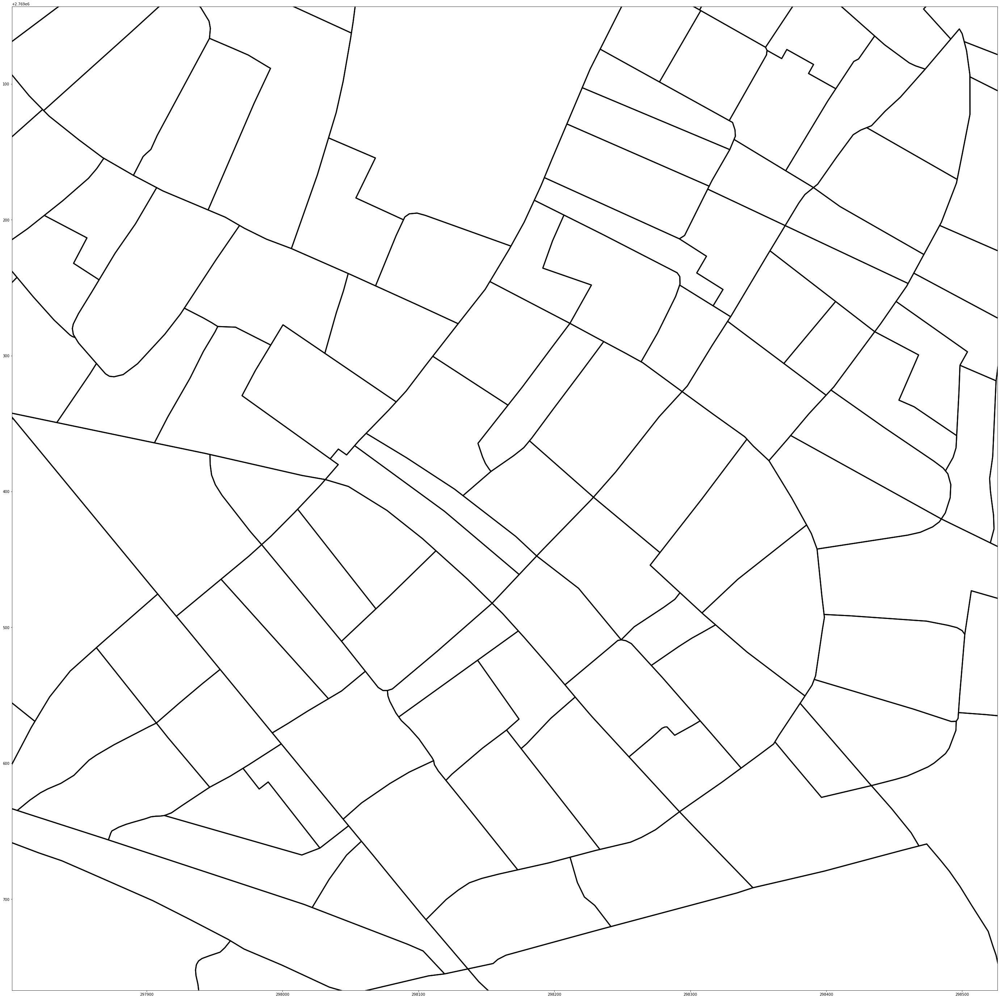

In [289]:
f, ax = plt.subplots(1, figsize=(50,50))
Socio_economic_database_POI_3826.plot(ax=ax, facecolor='none', edgecolor='black', linewidth=3)
ax.set_xlim(297801, 298526) 
ax.set_ylim(2769767,2769043) 


In [293]:
from matplotlib_scalebar.scalebar import ScaleBar


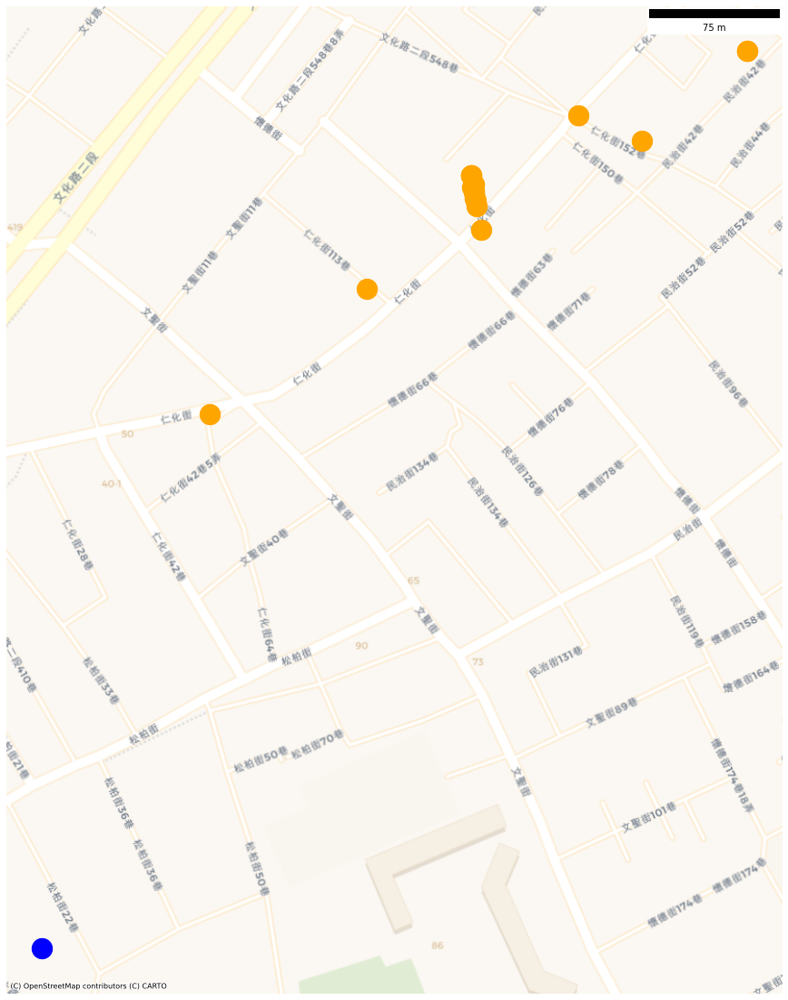

In [295]:
f, ax = plt.subplots(1, figsize=(20,20))
#Socio_economic_database_POI_3826.plot(ax=ax, facecolor='none', edgecolor='black', linewidth=3)

new_df_id_sort_true.iloc[0:20].plot( ax=ax,  color="orange" ,markersize=500)
new_df_id_sort_pred.iloc[19:20].plot( ax=ax,  color='blue' ,markersize=500)
#new_df_id_sort_adjust.iloc[19:20].plot( ax=ax,  color='red', markersize=500)
ax.add_artist(ScaleBar(1))
#Socio_economic_database_POI.plot()
#ax.set_xlim(297801, 298526) 
#ax.set_ylim(2769767,2769043) 
cx.add_basemap(ax,  crs='EPSG:3826', source=cx.providers.CartoDB.Voyager)

ax.set_axis_off()

plt.show()

# -------------------------------------------------------原始碼-----------------------------------------------

In [57]:
#按照差距排序
loc_diff_df_sort=loc_diff_df.sort_values(by=['dist_diff'])
#看四分位數
#loc_diff_df.describe()
#挑選75%以上的人#不行!結果還剩5000多人
#挑選前100名誤差最大的
#big_difference_dist_diff=loc_diff_df_sort[loc_diff_df['dist_diff']>10000]#.copy()
big_difference_dist_diff=loc_diff_df[(loc_diff_df['dist_diff'] >= 10000) & (loc_diff_df['dist_diff'] <= 50000)]
#big_difference_dist_diff = loc_diff_df.loc[loc_diff_df['device_id'].isin(peopl_df_list)]
#big_difference_dist_diff#=big_difference_dist_diff[120:140]
#ac=big_difference_dist_diff.plot(figsize=(50,50), cmap='Spectral_r', marker='o', markersize=300,column='dist_diff',legend=True)#figsize=(60,60)
#cx.add_basemap(ax=ac,crs='EPSG:3826',source=cx.providers.Stamen.TonerLite)

In [58]:
big_difference_dist_diff

,geom_x_median_pred,geom_y_median_pred,geom_x_median_true,geom_y_median_true,hr_sin,date_part_sin,geom_x_median,geom_y_median,geometry,geometry2,geometry3,dist_diff,device_id
15,293668.09375,2767115.25,283680,2.75879e+06,-0.136167,0.781831,292296,2.76379e+06,POINT (292295.622 2763792.152),POINT (293668.094 2767115.250),POINT (283680.285 2758790.397),13002.288463,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...
18,287316.65625,2765124.75,293622,2.77344e+06,0.398401,0,285744,2.76075e+06,POINT (285744.435 2760750.863),POINT (287316.656 2765124.750),POINT (293622.349 2773441.350),10436.837829,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...
41,294596.53125,2767401.75,285414,2.76106e+06,-0.136167,0,293833,2.76522e+06,POINT (293833.384 2765220.459),POINT (294596.531 2767401.750),POINT (285413.974 2761062.214),11158.363343,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...
57,294961.62500,2767512.25,287691,2.75888e+06,-0.631088,0.781831,294666,2.76352e+06,POINT (294666.113 2763520.672),POINT (294961.625 2767512.250),POINT (287690.635 2758882.390),11284.580948,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...
65,287237.25000,2765094.75,299108,2.76587e+06,0.136167,-0.781831,285820,2.75954e+06,POINT (285819.907 2759540.363),POINT (287237.250 2765094.750),POINT (299107.562 2765873.163),11895.807273,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...
...,...,...,...,...,...,...,...,...,...,...,...,...,...
35212,300192.03125,2769161.00,299968,2.78177e+06,0,-0.781831,299968,2.78177e+06,POINT (299968.073 2781772.168),POINT (300192.031 2769161.000),POINT (299968.073 2781772.168),12613.155963,VfOk55s1S4rqRrA1iRMkP5mSd0h7q5onvsENykEraxU/ce...
35213,300192.03125,2769161.00,299968,2.78177e+06,0,-0.781831,299968,2.78177e+06,POINT (299968.073 2781772.168),POINT (300192.031 2769161.000),POINT (299968.073 2781772.168),12613.155963,VfOk55s1S4rqRrA1iRMkP5mSd0h7q5onvsENykEraxU/ce...
35214,300192.03125,2769161.00,299968,2.78177e+06,0,-0.781831,299968,2.78177e+06,POINT (299968.073 2781772.168),POINT (300192.031 2769161.000),POINT (299968.073 2781772.168),12613.155963,VfOk55s1S4rqRrA1iRMkP5mSd0h7q5onvsENykEraxU/ce...
35215,300192.03125,2769161.00,299968,2.78177e+06,0,-0.781831,299968,2.78177e+06,POINT (299968.073 2781772.168),POINT (300192.031 2769161.000),POINT (299968.073 2781772.168),12613.155963,VfOk55s1S4rqRrA1iRMkP5mSd0h7q5onvsENykEraxU/ce...


In [172]:
#big_difference_dist_diff['device_id'][0]
#from scipy.spatial import distance,distance_matrix
#x=b.reshape(1,20)
#y =candidates[land_columns].values.astype('float')
distance_matrix(x,y).reshape(-1)

array([ 9.70584198, 11.2860146 ,  2.92994163, ..., 11.2860146 ,
        8.85139657, 10.43018442])

In [59]:
import warnings
from tqdm.notebook import tqdm
import sys
from scipy.spatial import distance_matrix

import pandas as pd
from pandas.core.common import SettingWithCopyWarning


warnings.simplefilter(action="ignore", category=SettingWithCopyWarning)
    


from scipy.spatial import distance
land_columns=['工商業總家數','農、林、漁、牧業','礦業及土石採取業',
                                            '製造業','電力及燃氣供應業','用水供應及污染整治業','營造業',
                                            '批發及零售業','運輸及倉儲業','住宿及餐飲業','資訊及通訊傳播業',
                                                    '金融及保險業','不動產業','專業、科學及技術服務業','支援服務業',
                                                    '公共行政及國防；強制性社會安全','教育服務業','醫療保健及社會工作服務業',
                                                   '藝術、娛樂及休閒服務業','其他服務業']
with tqdm(total=len(big_difference_dist_diff), file=sys.stdout) as pbar:
    new_df  = pd.DataFrame()
    for i in range(len(big_difference_dist_diff)):
        pbar.set_description('processed: %d' % (1 + i))
        pbar.update(1)
        test_data_loc = big_difference_dist_diff.iloc[i:i+1,:]
        test_data_loc['geometry'] = test_data_loc.buffer(10000)
        test_data_land = land_diff_df.iloc[i:i+1,0:20]
        xmin, ymin, xmax, ymax = test_data_loc.to_crs('EPSG:4326').total_bounds
        sql='''
        SELECT *
        FROM chi."Socio_economic_database_POI" 
        WHERE chi."Socio_economic_database_POI".geom && ST_MakeEnvelope({}, {}, {}, {} , 4326)
        '''.format(xmin, ymin, xmax, ymax)
        %time candidates=gpd.GeoDataFrame.from_postgis(sql, engine, geom_col='geom',crs='EPSG:4326').to_crs('EPSG:3826')
        similiarity=[]
        b=test_data_land[land_columns].iloc[0].values
        x=b.reshape(1,20)
        y =candidates[land_columns].values.astype('float') 
        %time candidates['similiarity'] =distance_matrix(x,y).reshape(-1)
        test_data_loc['adjust']= candidates.sort_values('similiarity').iloc[0]['geom'].centroid
        test_data_loc['adjust'] = test_data_loc['adjust'].astype('geometry')
        test_data_loc['dist_diff_adjust'] =  test_data_loc['adjust'].distance(test_data_loc['geometry3'])
        new_df = new_df.append(test_data_loc.copy(),ignore_index=True)


  0%|          | 0/2501 [00:00<?, ?it/s]

Wall time: 31 s
Wall time: 9.03 ms
Wall time: 27.7 s
Wall time: 996 µs
Wall time: 36.7 s
Wall time: 2.96 ms
Wall time: 57.7 s
Wall time: 3.96 ms
Wall time: 1min 16s
Wall time: 1.03 ms
Wall time: 1min 31s
Wall time: 3.99 ms
Wall time: 44.6 s
Wall time: 1.99 ms
Wall time: 1min 5s
Wall time: 2.99 ms
Wall time: 50 s
Wall time: 3.08 ms
Wall time: 1min 18s
Wall time: 3.99 ms
Wall time: 36.4 s
Wall time: 2 ms
Wall time: 32.7 s
Wall time: 1.99 ms
Wall time: 30.6 s
Wall time: 2.99 ms
Wall time: 33.7 s
Wall time: 2 ms
Wall time: 43.7 s
Wall time: 2.99 ms
Wall time: 50.8 s
Wall time: 3.02 ms
Wall time: 32.5 s
Wall time: 2.99 ms
Wall time: 45.9 s
Wall time: 3.96 ms
Wall time: 31.9 s
Wall time: 2.99 ms
Wall time: 37.7 s
Wall time: 3 ms
Wall time: 31.3 s
Wall time: 1.99 ms
Wall time: 45.9 s
Wall time: 3.99 ms
Wall time: 25.9 s
Wall time: 1.99 ms
Wall time: 42.7 s
Wall time: 3.99 ms
Wall time: 35 s
Wall time: 2 ms
Wall time: 32.4 s
Wall time: 1.97 ms
Wall time: 37.8 s
Wall time: 3.02 ms
Wall time: 45

Wall time: 12.1 s
Wall time: 0 ns
Wall time: 39.4 s
Wall time: 3.99 ms
Wall time: 38.6 s
Wall time: 3.99 ms
Wall time: 39.9 s
Wall time: 3.99 ms
Wall time: 8.56 s
Wall time: 1.54 ms
Wall time: 33 s
Wall time: 2.99 ms
Wall time: 27.3 s
Wall time: 1.97 ms
Wall time: 24.8 s
Wall time: 2 ms
Wall time: 33.5 s
Wall time: 2.02 ms
Wall time: 12 s
Wall time: 968 µs
Wall time: 31.3 s
Wall time: 2.99 ms
Wall time: 30.1 s
Wall time: 1.99 ms
Wall time: 40.5 s
Wall time: 4.05 ms
Wall time: 11.3 s
Wall time: 997 µs
Wall time: 12.1 s
Wall time: 0 ns
Wall time: 41.5 s
Wall time: 4.02 ms
Wall time: 25.4 s
Wall time: 1.99 ms
Wall time: 49.8 s
Wall time: 3.99 ms
Wall time: 42.1 s
Wall time: 3 ms
Wall time: 34.3 s
Wall time: 2.99 ms
Wall time: 21.5 s
Wall time: 998 µs
Wall time: 19.7 s
Wall time: 1 ms
Wall time: 26.3 s
Wall time: 2.02 ms
Wall time: 25.5 s
Wall time: 978 µs
Wall time: 49 s
Wall time: 3.99 ms
Wall time: 26.1 s
Wall time: 2 ms
Wall time: 30.2 s
Wall time: 3.01 ms
Wall time: 44.8 s
Wall time: 

Wall time: 24.1 s
Wall time: 2.99 ms
Wall time: 24.5 s
Wall time: 1.96 ms
Wall time: 24.5 s
Wall time: 2.93 ms
Wall time: 25.1 s
Wall time: 2.99 ms
Wall time: 23.5 s
Wall time: 2.99 ms
Wall time: 24.2 s
Wall time: 2.02 ms
Wall time: 23.9 s
Wall time: 1.99 ms
Wall time: 24.3 s
Wall time: 2.99 ms
Wall time: 24.2 s
Wall time: 2.02 ms
Wall time: 24.3 s
Wall time: 2.02 ms
Wall time: 24.5 s
Wall time: 2.02 ms
Wall time: 23.4 s
Wall time: 1.99 ms
Wall time: 24.4 s
Wall time: 2 ms
Wall time: 25.6 s
Wall time: 2.02 ms
Wall time: 24.5 s
Wall time: 1.99 ms
Wall time: 24.4 s
Wall time: 3.01 ms
Wall time: 24.5 s
Wall time: 2.99 ms
Wall time: 25.2 s
Wall time: 2.73 ms
Wall time: 24.8 s
Wall time: 1.99 ms
Wall time: 25.4 s
Wall time: 2 ms
Wall time: 25.6 s
Wall time: 2.99 ms
Wall time: 25.5 s
Wall time: 2.96 ms
Wall time: 25.3 s
Wall time: 2.03 ms
Wall time: 24.7 s
Wall time: 2.99 ms
Wall time: 24.5 s
Wall time: 2.99 ms
Wall time: 24.1 s
Wall time: 2.02 ms
Wall time: 23.7 s
Wall time: 1.99 ms
Wall ti

Wall time: 24.3 s
Wall time: 2 ms
Wall time: 23.4 s
Wall time: 2.02 ms
Wall time: 23.9 s
Wall time: 2.02 ms
Wall time: 23.5 s
Wall time: 2 ms
Wall time: 23.7 s
Wall time: 2.02 ms
Wall time: 23.9 s
Wall time: 3.18 ms
Wall time: 25 s
Wall time: 2.02 ms
Wall time: 24.4 s
Wall time: 1.99 ms
Wall time: 23.6 s
Wall time: 2.02 ms
Wall time: 25 s
Wall time: 1.99 ms
Wall time: 24.2 s
Wall time: 2.06 ms
Wall time: 23.8 s
Wall time: 3.02 ms
Wall time: 24.9 s
Wall time: 2.99 ms
Wall time: 23.5 s
Wall time: 2.99 ms
Wall time: 24 s
Wall time: 2 ms
Wall time: 24.6 s
Wall time: 2 ms
Wall time: 24.8 s
Wall time: 1.99 ms
Wall time: 25.1 s
Wall time: 2.99 ms
Wall time: 24.9 s
Wall time: 2.02 ms
Wall time: 24 s
Wall time: 2 ms
Wall time: 23.9 s
Wall time: 1.99 ms
Wall time: 24.4 s
Wall time: 3.02 ms
Wall time: 24.7 s
Wall time: 1.99 ms
Wall time: 24.6 s
Wall time: 2.99 ms
Wall time: 24.1 s
Wall time: 1.99 ms
Wall time: 23.8 s
Wall time: 1.99 ms
Wall time: 23.9 s
Wall time: 1.99 ms
Wall time: 24.3 s
Wall t

Wall time: 30.9 s
Wall time: 3.99 ms
Wall time: 16.4 s
Wall time: 1.03 ms
Wall time: 22.3 s
Wall time: 2.02 ms
Wall time: 12.3 s
Wall time: 998 µs
Wall time: 11.5 s
Wall time: 972 µs
Wall time: 26.3 s
Wall time: 2.99 ms
Wall time: 20.8 s
Wall time: 995 µs
Wall time: 15 s
Wall time: 1.03 ms
Wall time: 24.7 s
Wall time: 2.99 ms
Wall time: 23.5 s
Wall time: 3 ms
Wall time: 21.8 s
Wall time: 2 ms
Wall time: 22.7 s
Wall time: 1.96 ms
Wall time: 22.9 s
Wall time: 2 ms
Wall time: 23.6 s
Wall time: 2.02 ms
Wall time: 33.7 s
Wall time: 3.96 ms
Wall time: 20.3 s
Wall time: 1.93 ms
Wall time: 33.6 s
Wall time: 3.99 ms
Wall time: 10.4 s
Wall time: 993 µs
Wall time: 32.4 s
Wall time: 3.99 ms
Wall time: 8.17 s
Wall time: 975 µs
Wall time: 7.3 s
Wall time: 992 µs
Wall time: 8.64 s
Wall time: 974 µs
Wall time: 8.43 s
Wall time: 0 ns
Wall time: 8.82 s
Wall time: 997 µs
Wall time: 7.91 s
Wall time: 974 µs
Wall time: 8.6 s
Wall time: 0 ns
Wall time: 33.7 s
Wall time: 3.96 ms
Wall time: 14.8 s
Wall time: 

Wall time: 22.7 s
Wall time: 2.02 ms
Wall time: 22.6 s
Wall time: 2.96 ms
Wall time: 21.8 s
Wall time: 1.99 ms
Wall time: 22.8 s
Wall time: 2.03 ms
Wall time: 23.5 s
Wall time: 1.99 ms
Wall time: 23.3 s
Wall time: 2.03 ms
Wall time: 22.1 s
Wall time: 2 ms
Wall time: 23 s
Wall time: 2.05 ms
Wall time: 23.3 s
Wall time: 3.02 ms
Wall time: 23 s
Wall time: 1.99 ms
Wall time: 22.7 s
Wall time: 2.99 ms
Wall time: 22.8 s
Wall time: 2 ms
Wall time: 23.4 s
Wall time: 1.96 ms
Wall time: 22.3 s
Wall time: 1.97 ms
Wall time: 23.4 s
Wall time: 1.99 ms
Wall time: 22.6 s
Wall time: 2.02 ms
Wall time: 23.7 s
Wall time: 2.02 ms
Wall time: 23 s
Wall time: 2.72 ms
Wall time: 22.9 s
Wall time: 2.92 ms
Wall time: 22.8 s
Wall time: 1.99 ms
Wall time: 23.6 s
Wall time: 1.99 ms
Wall time: 23.2 s
Wall time: 2.03 ms
Wall time: 23.4 s
Wall time: 2.03 ms
Wall time: 23.5 s
Wall time: 2.99 ms
Wall time: 22.6 s
Wall time: 3.02 ms
Wall time: 23.5 s
Wall time: 1.92 ms
Wall time: 23 s
Wall time: 1.82 ms
Wall time: 23 s

Wall time: 24 s
Wall time: 1.99 ms
Wall time: 22.7 s
Wall time: 2.06 ms
Wall time: 28.9 s
Wall time: 2.99 ms
Wall time: 37.5 s
Wall time: 3.99 ms
Wall time: 13.1 s
Wall time: 998 µs
Wall time: 6.56 s
Wall time: 0 ns
Wall time: 5.07 s
Wall time: 0 ns
Wall time: 5.19 s
Wall time: 0 ns
Wall time: 10.6 s
Wall time: 0 ns
Wall time: 32.3 s
Wall time: 3.02 ms
Wall time: 29.3 s
Wall time: 3.02 ms
Wall time: 24.3 s
Wall time: 2.02 ms
Wall time: 8.63 s
Wall time: 998 µs
Wall time: 10.5 s
Wall time: 0 ns
Wall time: 10.9 s
Wall time: 0 ns
Wall time: 10.4 s
Wall time: 997 µs
Wall time: 10.5 s
Wall time: 1.22 ms
Wall time: 10.4 s
Wall time: 0 ns
Wall time: 12.2 s
Wall time: 998 µs
Wall time: 13.1 s
Wall time: 0 ns
Wall time: 8.13 s
Wall time: 0 ns
Wall time: 8.11 s
Wall time: 0 ns
Wall time: 7.84 s
Wall time: 998 µs
Wall time: 8.86 s
Wall time: 0 ns
Wall time: 8.41 s
Wall time: 975 µs
Wall time: 8.32 s
Wall time: 0 ns
Wall time: 8.17 s
Wall time: 997 µs
Wall time: 16.6 s
Wall time: 0 ns
Wall time: 1

Wall time: 16.9 s
Wall time: 976 µs
Wall time: 16.2 s
Wall time: 0 ns
Wall time: 17.8 s
Wall time: 1.02 ms
Wall time: 19.4 s
Wall time: 998 µs
Wall time: 19.5 s
Wall time: 998 µs
Wall time: 18.4 s
Wall time: 998 µs
Wall time: 18.9 s
Wall time: 995 µs
Wall time: 29.4 s
Wall time: 2.98 ms
Wall time: 17.5 s
Wall time: 998 µs
Wall time: 17.4 s
Wall time: 0 ns
Wall time: 17.4 s
Wall time: 998 µs
Wall time: 16.7 s
Wall time: 977 µs
Wall time: 17.3 s
Wall time: 996 µs
Wall time: 16.4 s
Wall time: 974 µs
Wall time: 17.3 s
Wall time: 0 ns
Wall time: 16.7 s
Wall time: 998 µs
Wall time: 17.4 s
Wall time: 998 µs
Wall time: 13.6 s
Wall time: 998 µs
Wall time: 34.6 s
Wall time: 4.02 ms
Wall time: 34.2 s
Wall time: 3.98 ms
Wall time: 27.1 s
Wall time: 2.99 ms
Wall time: 16.9 s
Wall time: 968 µs
Wall time: 13.8 s
Wall time: 0 ns
Wall time: 13.9 s
Wall time: 995 µs
Wall time: 14.8 s
Wall time: 975 µs
Wall time: 15.2 s
Wall time: 968 µs
Wall time: 14.1 s
Wall time: 998 µs
Wall time: 14.8 s
Wall time: 99

Wall time: 7.92 s
Wall time: 998 µs
Wall time: 7.72 s
Wall time: 997 µs
Wall time: 8.1 s
Wall time: 998 µs
Wall time: 9.05 s
Wall time: 0 ns
Wall time: 9.05 s
Wall time: 974 µs
Wall time: 9.49 s
Wall time: 0 ns
Wall time: 8.98 s
Wall time: 1.24 ms
Wall time: 17 s
Wall time: 942 µs
Wall time: 16.1 s
Wall time: 991 µs
Wall time: 16.8 s
Wall time: 998 µs
Wall time: 17 s
Wall time: 968 µs
Wall time: 16.2 s
Wall time: 998 µs
Wall time: 15.9 s
Wall time: 964 µs
Wall time: 15.8 s
Wall time: 997 µs
Wall time: 8.39 s
Wall time: 0 ns
Wall time: 8.1 s
Wall time: 997 µs
Wall time: 8.06 s
Wall time: 997 µs
Wall time: 17 s
Wall time: 987 µs
Wall time: 16.3 s
Wall time: 1.02 ms
Wall time: 11.1 s
Wall time: 0 ns
Wall time: 8.14 s
Wall time: 975 µs
Wall time: 7.74 s
Wall time: 998 µs
Wall time: 8.32 s
Wall time: 0 ns
Wall time: 8.03 s
Wall time: 1 ms
Wall time: 8.33 s
Wall time: 0 ns
Wall time: 7.82 s
Wall time: 0 ns
Wall time: 7.99 s
Wall time: 1.01 ms
Wall time: 8.42 s
Wall time: 1 ms
Wall time: 7.7 

Wall time: 14.1 s
Wall time: 1.02 ms
Wall time: 13.4 s
Wall time: 0 ns
Wall time: 14.5 s
Wall time: 968 µs
Wall time: 14.7 s
Wall time: 998 µs
Wall time: 14.2 s
Wall time: 0 ns
Wall time: 14.7 s
Wall time: 0 ns
Wall time: 14.2 s
Wall time: 973 µs
Wall time: 14 s
Wall time: 998 µs
Wall time: 14 s
Wall time: 0 ns
Wall time: 14.9 s
Wall time: 996 µs
Wall time: 15 s
Wall time: 0 ns
Wall time: 14.3 s
Wall time: 0 ns
Wall time: 14.8 s
Wall time: 967 µs
Wall time: 14.9 s
Wall time: 997 µs
Wall time: 14.3 s
Wall time: 0 ns
Wall time: 14.6 s
Wall time: 0 ns
Wall time: 28.2 s
Wall time: 997 µs
Wall time: 1min 8s
Wall time: 997 µs
Wall time: 42.5 s
Wall time: 999 µs
Wall time: 15.1 s
Wall time: 976 µs
Wall time: 15.5 s
Wall time: 968 µs
Wall time: 15.3 s
Wall time: 968 µs
Wall time: 14.2 s
Wall time: 997 µs
Wall time: 31 s
Wall time: 2.99 ms
Wall time: 23.1 s
Wall time: 2 ms
Wall time: 21.9 s
Wall time: 1.99 ms
Wall time: 22.6 s
Wall time: 2.02 ms
Wall time: 21.9 s
Wall time: 1.99 ms
Wall time: 1

Wall time: 17.2 s
Wall time: 1.05 ms
Wall time: 17.4 s
Wall time: 1 ms
Wall time: 14.9 s
Wall time: 968 µs
Wall time: 15 s
Wall time: 997 µs
Wall time: 14.4 s
Wall time: 1 ms
Wall time: 15 s
Wall time: 997 µs
Wall time: 14.6 s
Wall time: 0 ns
Wall time: 15 s
Wall time: 0 ns
Wall time: 14.4 s
Wall time: 998 µs
Wall time: 15 s
Wall time: 0 ns
Wall time: 14 s
Wall time: 0 ns
Wall time: 14.8 s
Wall time: 998 µs
Wall time: 15 s
Wall time: 998 µs
Wall time: 15 s
Wall time: 0 ns
Wall time: 14.9 s
Wall time: 996 µs
Wall time: 15.2 s
Wall time: 1.02 ms
Wall time: 14.9 s
Wall time: 997 µs
Wall time: 14.8 s
Wall time: 998 µs
Wall time: 15.1 s
Wall time: 974 µs
Wall time: 14.7 s
Wall time: 1.02 ms
Wall time: 14.5 s
Wall time: 0 ns
Wall time: 14.2 s
Wall time: 998 µs
Wall time: 14.2 s
Wall time: 997 µs
Wall time: 14.2 s
Wall time: 975 µs
Wall time: 15 s
Wall time: 938 µs
Wall time: 14.9 s
Wall time: 998 µs
Wall time: 14.8 s
Wall time: 994 µs
Wall time: 14.9 s
Wall time: 0 ns
Wall time: 14.8 s
Wall 

In [60]:
new_df

,geom_x_median_pred,geom_y_median_pred,geom_x_median_true,geom_y_median_true,hr_sin,date_part_sin,geom_x_median,geom_y_median,geometry,geometry2,geometry3,dist_diff,device_id,adjust,dist_diff_adjust
0,293668.09375,2767115.25,283680,2.75879e+06,-0.136167,0.781831,292296,2.76379e+06,"POLYGON ((302295.622 2763792.152, 302247.470 2...",POINT (293668.094 2767115.250),POINT (283680.285 2758790.397),13002.288463,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,POINT (295824.432 2767757.357),15095.916166
1,287316.65625,2765124.75,293622,2.77344e+06,0.398401,0,285744,2.76075e+06,"POLYGON ((295744.435 2760750.863, 295696.282 2...",POINT (287316.656 2765124.750),POINT (293622.349 2773441.350),10436.837829,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,POINT (275875.510 2758399.031),23264.170448
2,294596.53125,2767401.75,285414,2.76106e+06,-0.136167,0,293833,2.76522e+06,"POLYGON ((303833.384 2765220.459, 303785.231 2...",POINT (294596.531 2767401.750),POINT (285413.974 2761062.214),11158.363343,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,POINT (297492.461 2768238.183),14049.355452
3,294961.62500,2767512.25,287691,2.75888e+06,-0.631088,0.781831,294666,2.76352e+06,"POLYGON ((304666.113 2763520.672, 304617.961 2...",POINT (294961.625 2767512.250),POINT (287690.635 2758882.390),11284.580948,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,POINT (301514.102 2767410.280),16242.325186
4,287237.25000,2765094.75,299108,2.76587e+06,0.136167,-0.781831,285820,2.75954e+06,"POLYGON ((295819.907 2759540.363, 295771.754 2...",POINT (287237.250 2765094.750),POINT (299107.562 2765873.163),11895.807273,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,POINT (275875.510 2758399.031),24404.730844
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2496,300192.03125,2769161.00,299968,2.78177e+06,0,-0.781831,299968,2.78177e+06,"POLYGON ((309968.073 2781772.168, 309919.921 2...",POINT (300192.031 2769161.000),POINT (299968.073 2781772.168),12613.155963,VfOk55s1S4rqRrA1iRMkP5mSd0h7q5onvsENykEraxU/ce...,POINT (301630.440 2775041.307),6933.105457
2497,300192.03125,2769161.00,299968,2.78177e+06,0,-0.781831,299968,2.78177e+06,"POLYGON ((309968.073 2781772.168, 309919.921 2...",POINT (300192.031 2769161.000),POINT (299968.073 2781772.168),12613.155963,VfOk55s1S4rqRrA1iRMkP5mSd0h7q5onvsENykEraxU/ce...,POINT (302916.055 2772043.104),10165.887648
2498,300192.03125,2769161.00,299968,2.78177e+06,0,-0.781831,299968,2.78177e+06,"POLYGON ((309968.073 2781772.168, 309919.921 2...",POINT (300192.031 2769161.000),POINT (299968.073 2781772.168),12613.155963,VfOk55s1S4rqRrA1iRMkP5mSd0h7q5onvsENykEraxU/ce...,POINT (299432.450 2773411.067),8378.239690
2499,300192.03125,2769161.00,299968,2.78177e+06,0,-0.781831,299968,2.78177e+06,"POLYGON ((309968.073 2781772.168, 309919.921 2...",POINT (300192.031 2769161.000),POINT (299968.073 2781772.168),12613.155963,VfOk55s1S4rqRrA1iRMkP5mSd0h7q5onvsENykEraxU/ce...,POINT (300771.516 2773623.398),8188.281767


In [61]:
new_df[['dist_diff','dist_diff_adjust']].mean()

dist_diff           14702.560202
dist_diff_adjust     9930.109309
dtype: float64

<AxesSubplot:>

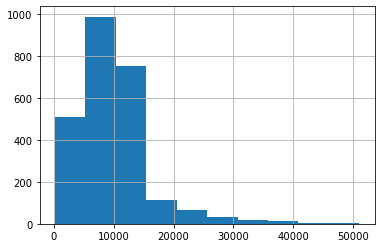

In [64]:
new_df['dist_diff_adjust'].hist()

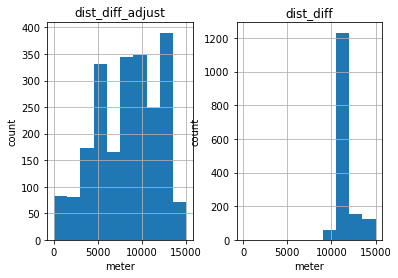

In [62]:


axs=new_df[['dist_diff_adjust','dist_diff']].hist(bins=10, range=(0,15000))

for ax in axs.flat:
    ax.set(xlabel='meter', ylabel='count')

plt.show()

# -----------------------------------------------------結束----------------------------------------------------

121.39471060828119 24.989625205954752 121.43433953305693 25.02573775007425


<AxesSubplot:>

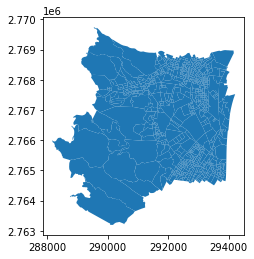

In [1865]:
sql='''
SELECT *
FROM chi."Socio_economic_database_POI" 
WHERE chi."Socio_economic_database_POI".geom && ST_MakeEnvelope({}, {}, {}, {} ,4326)
'''.format(xmin, ymin, xmax, ymax)
test_data_loc['geometry']= test_data_loc['geometry'].centroid
test_data_loc['geometry'] = test_data_loc.buffer(2000)
test_data_land = land_diff_df.iloc[i:i+1,0:20]
xmin, ymin, xmax, ymax = test_data_loc.to_crs('EPSG:4326').total_bounds
candidates=gpd.GeoDataFrame.from_postgis(sql, engine, geom_col='geom',crs='EPSG:4326').to_crs('EPSG:3826')
print(xmin, ymin, xmax, ymax)
candidates.plot()

In [2002]:
new_df2 = new_df.copy()
new_df2['pred_loc'] = gpd.points_from_xy(new_df2.geom_x_median_pred, new_df2.geom_y_median_pred)
new_df2['true_loc'] = gpd.points_from_xy(new_df2.geom_x_median_true, new_df2.geom_y_median_true)
new_df2 =gpd.GeoDataFrame(new_df2,geometry='true_loc')
new_df2['pred_loc'] =new_df2['pred_loc'].astype('geometry')
new_df2['true_loc'] =new_df2['true_loc'].astype('geometry')
new_df2['adjust'] = new_df2['adjust'].astype('geometry')
#new_df2=new_df2[['device_id','pred_loc','true_loc','adjust']]
new_df2['before'] = new_df2['pred_loc'].distance(new_df2['true_loc'])
new_df2['after'] = new_df2['adjust'].distance(new_df2['true_loc'])
new_df2['improve'] = new_df2['before']-new_df2['after']


In [2013]:
peopl_df.device_id.nunique()

9

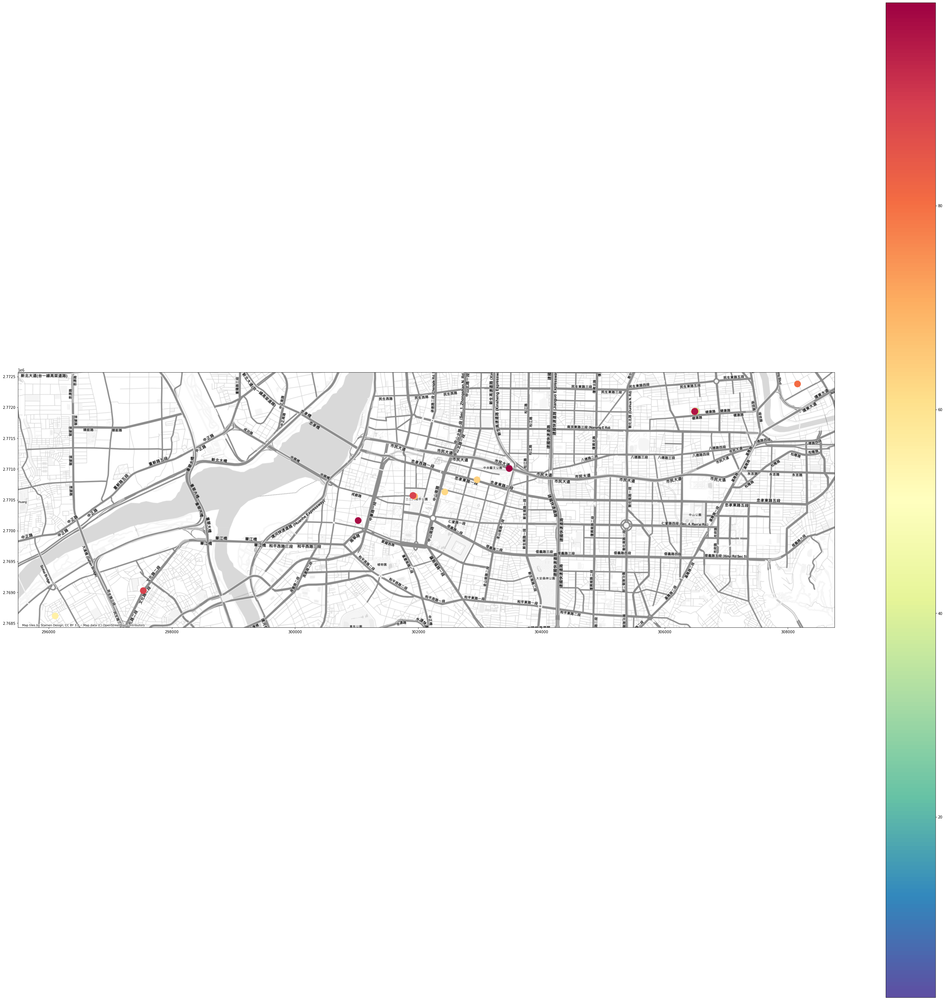

In [2016]:


peopl_df = new_df2.loc[new_df2['before']<100]

ax=peopl_df.plot(figsize=(50,50), cmap='Spectral_r', marker='o', markersize=300,column='before',legend=True)#figsize=(60,60)


cx.add_basemap(ax=ax,crs='EPSG:3826',source=cx.providers.Stamen.TonerLite)
#testuser = new_df2.loc[new_df2['device_id']=='fj6yiaFZ1Pp6SwCN3xPqsB8LRQ9EdAwwnd0buEIKykpLQ9XTjpCkbo95MJrz++vX']
#testuser = new_df2.loc[new_df2['improve']<0]
#ax=testuser.plot(figsize=(50,50), cmap='Spectral_r', marker='o', markersize=300,column='improve',legend=True)#figsize=(60,60)


#cx.add_basemap(ax=ax,crs='EPSG:3826',source=cx.providers.Stamen.TonerLite)

In [2015]:
pid=peopl_df.iloc[-5][0]

In [1984]:
df=loc_diff_df[loc_diff_df['device_id']==pid]#['dist_diff'].mean()
df

,geom_x_median_pred,geom_y_median_pred,geom_x_median_true,geom_y_median_true,hr_sin,date_part_sin,geom_x_median,geom_y_median,geometry,geometry2,geometry3,dist_diff,device_id
20116,292236.90625,2767412.25,292284,2.76809e+06,-0.631088,-0.781831,290396,2.7618e+06,POINT (290396.098 2761797.459),POINT (292236.906 2767412.250),POINT (292284.077 2768086.500),675.898269,eZOQZZP14b7uBGuRVe9WkgJqzrUwknAIpnuglZT5MHW5d2...
20081,294343.00000,2768070.75,291840,2.76669e+06,0.136167,-0.781831,294717,2.77499e+06,POINT (294716.712 2774991.135),POINT (294343.000 2768070.750),POINT (291839.796 2766692.364),2857.617497,eZOQZZP14b7uBGuRVe9WkgJqzrUwknAIpnuglZT5MHW5d2...
20117,293002.12500,2767650.00,292442,2.76365e+06,-0.997669,0.433884,292284,2.76809e+06,POINT (292284.077 2768086.500),POINT (293002.125 2767650.000),POINT (292442.185 2763645.000),4043.953184,eZOQZZP14b7uBGuRVe9WkgJqzrUwknAIpnuglZT5MHW5d2...
20119,293379.56250,2767769.50,292442,2.76364e+06,-0.81697,0.433884,292442,2.76364e+06,POINT (292442.410 2763643.904),POINT (293379.562 2767769.500),POINT (292441.925 2763644.080),4230.632898,eZOQZZP14b7uBGuRVe9WkgJqzrUwknAIpnuglZT5MHW5d2...
20120,293396.15625,2767776.50,292441,2.76364e+06,-0.136167,0.433884,292442,2.76364e+06,POINT (292441.925 2763644.080),POINT (293396.156 2767776.500),POINT (292441.221 2763643.070),4242.304291,eZOQZZP14b7uBGuRVe9WkgJqzrUwknAIpnuglZT5MHW5d2...
...,...,...,...,...,...,...,...,...,...,...,...,...,...
20121,293376.28125,2767770.25,305631,2.77394e+06,0.136167,0.433884,292441,2.76364e+06,POINT (292441.221 2763643.070),POINT (293376.281 2767770.250),POINT (305631.192 2773939.727),13720.251143,eZOQZZP14b7uBGuRVe9WkgJqzrUwknAIpnuglZT5MHW5d2...
20083,325304.93750,2777833.50,294782,2.77526e+06,-0.979084,0,342177,2.77956e+06,POINT (342177.237 2779557.317),POINT (325304.938 2777833.500),POINT (294782.183 2775260.479),30631.013569,eZOQZZP14b7uBGuRVe9WkgJqzrUwknAIpnuglZT5MHW5d2...
20109,319968.00000,2776146.25,288025,2.77358e+06,-0.979084,0,336651,2.7798e+06,POINT (336651.015 2779800.175),POINT (319968.000 2776146.250),POINT (288024.770 2773582.174),32045.974008,eZOQZZP14b7uBGuRVe9WkgJqzrUwknAIpnuglZT5MHW5d2...
20108,289216.37500,2766447.00,336651,2.7798e+06,-0.519584,0,287900,2.77373e+06,POINT (287899.698 2773725.444),POINT (289216.375 2766447.000),POINT (336651.015 2779800.175),49278.315026,eZOQZZP14b7uBGuRVe9WkgJqzrUwknAIpnuglZT5MHW5d2...


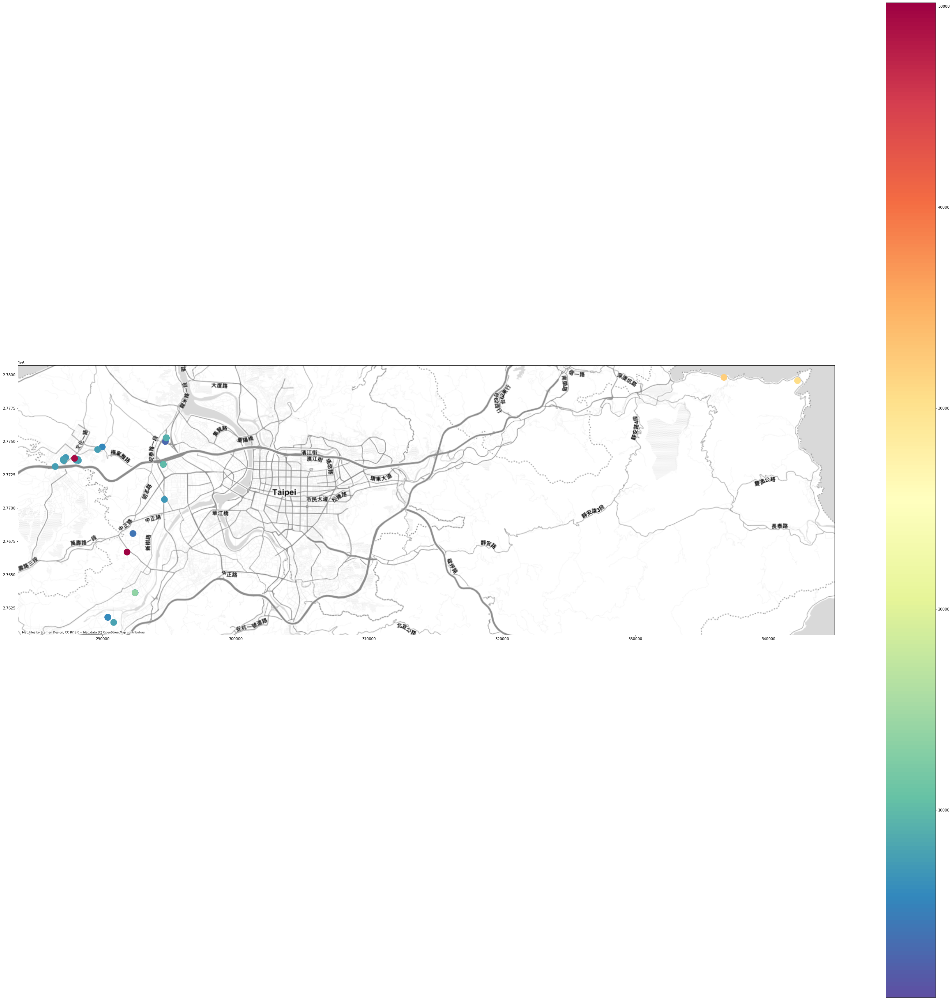

In [1985]:

ac=df.plot(figsize=(50,50), cmap='Spectral_r', marker='o', markersize=300,column='dist_diff',legend=True)#figsize=(60,60)
cx.add_basemap(ax=ac,crs='EPSG:3826',source=cx.providers.Stamen.TonerLite)

In [1950]:
#1dPLfMJER06wXpYlyHnxRFWsRcwWB78OZ05SlLES9T7mLFNxO+PWQ1Am2aDL2O94 改善很大的
new_df2

,device_id,pred_loc,true_loc,adjust,before,after,improve
0,RYtUDoTdYTkcvNjZ15C6CbCj2b3LCg16yEn6BjdgqfH3xr...,POINT (306487.438 2771936.500),POINT (306489.598 2771935.739),POINT (292419.298 2769814.020),2.290830,14229.372415,-14227.081585
1,RYtUDoTdYTkcvNjZ15C6CbCj2b3LCg16yEn6BjdgqfH3xr...,POINT (306494.250 2771938.750),POINT (306492.043 2771937.533),POINT (293429.467 2770346.337),2.520731,13159.132990,-13156.612258
2,RYtUDoTdYTkcvNjZ15C6CbCj2b3LCg16yEn6BjdgqfH3xr...,POINT (306487.781 2771936.500),POINT (306491.883 2771937.189),POINT (293631.830 2772242.137),4.158863,12863.667709,-12859.508847
3,RYtUDoTdYTkcvNjZ15C6CbCj2b3LCg16yEn6BjdgqfH3xr...,POINT (306486.938 2771936.500),POINT (306492.023 2771937.389),POINT (292419.298 2769814.020),5.162683,14232.016173,-14226.853489
4,RYtUDoTdYTkcvNjZ15C6CbCj2b3LCg16yEn6BjdgqfH3xr...,POINT (306494.531 2771937.000),POINT (306489.138 2771937.299),POINT (295182.059 2771509.485),5.401761,11315.169426,-11309.767665
...,...,...,...,...,...,...,...
23104,ZxaZMtFnFIvgibWea0Bf1BUUJOnQhIk9nAuKLp6MNtqcst...,POINT (296181.250 2768663.250),POINT (338443.550 2768956.141),POINT (295417.056 2770221.811),42263.315292,43045.105894,-781.790601
23105,ZxaZMtFnFIvgibWea0Bf1BUUJOnQhIk9nAuKLp6MNtqcst...,POINT (337130.125 2781621.500),POINT (291659.993 2783670.287),POINT (293613.344 2774181.591),45516.265632,9687.669510,35828.596121
23106,ZxaZMtFnFIvgibWea0Bf1BUUJOnQhIk9nAuKLp6MNtqcst...,POINT (297610.719 2769117.500),POINT (342106.377 2779429.222),POINT (293786.120 2772177.617),45674.886249,48861.365296,-3186.479047
23107,eZOQZZP14b7uBGuRVe9WkgJqzrUwknAIpnuglZT5MHW5d2...,POINT (289216.375 2766447.000),POINT (336651.015 2779800.175),POINT (295584.182 2771080.720),49278.315026,41982.301273,7296.013753


<AxesSubplot:xlabel='before', ylabel='after'>

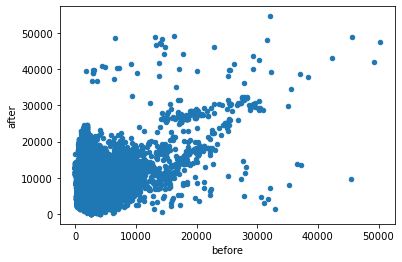

In [1933]:
new_df3 =new_df2[['before','after']]
new_df3.plot.scatter(x='before',y = 'after')

<AxesSubplot:>

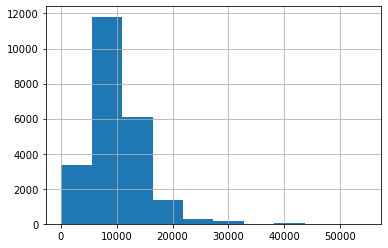

In [1906]:
new_df['dist_diff_adjust'].hist()

<AxesSubplot:>

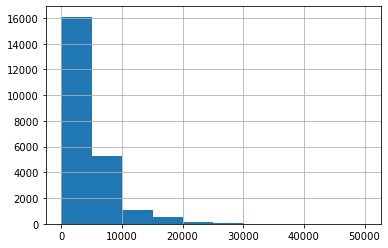

In [1907]:
new_df['dist_diff'].hist()

In [108]:
new_df[['dist_diff','dist_diff_adjust']].mean()

dist_diff           350.967741
dist_diff_adjust    134.742992
dtype: float64

<AxesSubplot:xlabel='after', ylabel='before'>

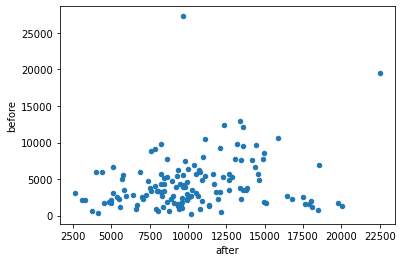

In [1912]:
peopl_df = new_df2[['device_id','before','after']].groupby('device_id').mean().reset_index()
peopl_df['improve'] = peopl_df['before']-peopl_df['after']
peopl_df.sort_values('improve').plot.scatter(x='after',y='before')


In [ ]:
loc_diff_df['geometry'] = loc_diff_df['geometry'].apply(lambda x: WKTElement(x.wkt, srid=3826))
#lstm_NOT_home_cyclic['geom_2'] = lstm_NOT_home_cyclic['geometry_2'].apply(lambda x: WKTElement(x.wkt, srid=4326))
lstm_NOT_home_cyclic.drop('geometry',1,inplace=True)

In [ ]:
lstm_NOT_home_cyclic.to_sql('lstm_NOT_home_cyclic', engine, if_exists='replace',index=False,schema='chi', dtype={'geom': Geometry('POINT', srid = 4326),'geom_2': Geometry('POINT', srid = 4326)})

---------------------------------------------

test_data_loc = loc_diff_df[5:6]
test_data_loc.crs='EPSG:3826'
test_data_loc['geometry'] = test_data_loc.buffer(2000)

test_data_loc.plot()

In [1571]:
test_data_land = land_diff_df.iloc[5:6,0:20]
test_data_land.crs='EPSG:3826'

<ipython-input-1571-939812bdec6e>:2: FutureWarning: Assigning CRS to a GeoDataFrame without a geometry column is now deprecated and will not be supported in the future.
  test_data_land.crs='EPSG:3826'


In [1572]:
land_columns=['工商業總家數','農、林、漁、牧業','礦業及土石採取業',
                                            '製造業','電力及燃氣供應業','用水供應及污染整治業','營造業',
                                            '批發及零售業','運輸及倉儲業','住宿及餐飲業','資訊及通訊傳播業',
                                                    '金融及保險業','不動產業','專業、科學及技術服務業','支援服務業',
                                                    '公共行政及國防；強制性社會安全','教育服務業','醫療保健及社會工作服務業',
                                                    '藝術、娛樂及休閒服務業','其他服務業']

In [1573]:
test_data_land.columns

Index(['工商業總家數', '農、林、漁、牧業', '礦業及土石採取業', '製造業', '電力及燃氣供應業', '用水供應及污染整治業',
       '營造業', '批發及零售業', '運輸及倉儲業', '住宿及餐飲業', '資訊及通訊傳播業', '金融及保險業', '不動產業',
       '專業、科學及技術服務業', '支援服務業', '公共行政及國防；強制性社會安全', '教育服務業', '醫療保健及社會工作服務業',
       '藝術、娛樂及休閒服務業', '其他服務業'],
      dtype='object')

In [1574]:
candidates= gpd.sjoin(Socio_economic_database_POI.to_crs('EPSG:3826'), test_data_loc, how="inner")

In [1576]:
similiarity=[]
b=test_data_land[land_columns].iloc[0].values
for index, row in candidates.iterrows():
    a =row[land_columns].values.astype('float')
    similiarity.append(distance.euclidean(a,b))

In [1577]:
candidates['similiarity'] =similiarity

In [1578]:
candidates['geom']

11507    POLYGON ((296021.730 2771699.551, 296084.788 2...
11508    POLYGON ((295890.455 2771604.522, 295891.841 2...
11510    POLYGON ((296087.213 2771534.910, 296142.374 2...
11511    POLYGON ((295156.991 2771532.353, 295176.175 2...
11513    POLYGON ((295336.061 2771203.593, 295368.155 2...
                               ...                        
26371    POLYGON ((294827.329 2772799.627, 294846.556 2...
26376    POLYGON ((294061.102 2772876.004, 294062.999 2...
26388    POLYGON ((294453.491 2772638.492, 294477.765 2...
26399    POLYGON ((294477.765 2772592.947, 294595.386 2...
26414    POLYGON ((294403.176 2772171.296, 294377.383 2...
Name: geom, Length: 656, dtype: geometry

In [1582]:
test_data_loc['adjust']= candidates.sort_values('similiarity').iloc[0]['geom'].centroid
test_data_loc['adjust'] = test_data_loc['adjust'].astype('geometry')

C:\Users\GIS519\Anaconda3\envs\python38\lib\site-packages\geopandas\geodataframe.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


In [1583]:
test_data_loc['dist_diff_adjust'] =  test_data_loc['adjust'].distance(test_data_loc['geometry3'])

In [1584]:
 test_data_loc

,geom_x_median_pred,geom_y_median_pred,geom_x_median_true,geom_y_median_true,hr_sin,date_part_sin,geom_x_median,geom_y_median,geometry,geometry2,geometry3,dist_diff,device_id,adjust,dist_diff_adjust
5,296664.125,2768814.0,296162,2.77284e+06,-0.631088,0.433884,296162,2.77284e+06,"POLYGON ((298162.163 2772843.716, 298152.532 2...",POINT (296664.125 2768814.000),POINT (296162.163 2772843.716),4060.859061,fj6yiaFZ1Pp6SwCN3xPqsB8LRQ9EdAwwnd0buEIKykpLQ9...,POINT (295715.995 2770980.688),1915.708397


In [1439]:
Socio_economic_database_POI

,CODEBASE,TOWN,COUNTY,醫療院所家數,老人安養機構家數,社區照顧關懷據點家數,兒童福利服務機構家數,婦幼福利服務機構家數,老人安養、養護、長期照護機構家數,居家服務支援中心家數,...,不動產業,專業、科學及技術服務業,支援服務業,公共行政及國防；強制性社會安全,教育服務業,醫療保健及社會工作服務業,藝術、娛樂及休閒服務業,其他服務業,資料時間,geom
0,A6301-0001-00,松山區,臺北市,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,108Y,"POLYGON ((121.55629 25.07494, 121.55741 25.074..."
1,A6301-0002-00,松山區,臺北市,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,108Y,"POLYGON ((121.56292 25.07155, 121.56320 25.071..."
2,A6301-0003-00,松山區,臺北市,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,2,108Y,"POLYGON ((121.55699 25.07261, 121.55697 25.072..."
3,A6301-0004-00,松山區,臺北市,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,108Y,"POLYGON ((121.55222 25.07344, 121.55541 25.073..."
4,A6301-0005-00,松山區,臺北市,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,108Y,"POLYGON ((121.55106 25.07226, 121.55152 25.072..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28762,A6529-0022-00,烏來區,新北市,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,108Y,"POLYGON ((121.44838 24.78437, 121.44862 24.784..."
28763,A6529-0023-00,烏來區,新北市,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,108Y,"POLYGON ((121.56575 24.80020, 121.56584 24.799..."
28764,A6529-0003-00,烏來區,新北市,1,0,1,0,0,0,0,...,0,0,0,0,0,0,0,1,108Y,"POLYGON ((121.54424 24.87550, 121.54425 24.875..."
28765,A6529-0004-00,烏來區,新北市,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,108Y,"POLYGON ((121.55155 24.88979, 121.55161 24.889..."


-----------------------------

In [ ]:
distdiff_list=np.array(distdiff_list)
plt.hist(distdiff_list)

#diff_gdf_500=diff_gdf.loc[diff_gdf['dist_diff']<=500]
diff_gdf[[ 'geom_y_median_pred','geom_y_median_true', 'geom_y_median']] /= lstm_NOT_home_cyclic["geom_y"].median()
diff_gdf[['geom_x_median_pred', 'geom_x_median_true','geom_x_median']] /=  lstm_NOT_home_cyclic["geom_x"].median()
diff_gdf

In [911]:
#pd.merge(diff_gdf,lstm_NOT_home_cyclic,on=['geom_x_median','geom_y_median','device_id_x'])
lstm_NOT_home_cyclic

,distance,device_id_x,PK,to_date_x,center,radius,km2,angle_sin,angle_cos,hr_sin,...,geom,center_point,geom_x,geom_y,center_x,center_y,geom_x_median,geom_y_median,center_x_median,center_y_median
0,0.000000,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,2020-02-24,"(275615.282273069,2769250.7677608803)",3383.320439,35.903623,NaN,NaN,-0.631088,...,POINT (246741.331 2745875.100),POINT (275615.282 2769250.768),246741.331173,2.745875e+06,275615.282273,2.769251e+06,0.841840,0.993186,0.940818,1.001986
1,18164.751546,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,2020-02-24,"(275615.282273069,2769250.7677608803)",3383.320439,35.903623,0.754604,-0.656181,-0.398401,...,POINT (262921.102 2754131.807),POINT (275615.282 2769250.768),262921.102041,2.754132e+06,275615.282273,2.769251e+06,0.897043,0.996172,0.940818,1.001986
2,22719.715908,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,2020-02-24,"(275615.282273069,2769250.7677608803)",3383.320439,35.903623,0.864543,0.502558,-0.398401,...,POINT (273370.209 2774306.089),POINT (275615.282 2769250.768),273370.209082,2.774306e+06,275615.282273,2.769251e+06,0.932694,1.003469,0.940818,1.001986
3,2570.769435,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,2020-02-24,"(275615.282273069,2769250.7677608803)",3383.320439,35.903623,0.324532,-0.945875,0.136167,...,POINT (275897.858 2774774.967),POINT (275615.282 2769250.768),275897.857969,2.774775e+06,275615.282273,2.769251e+06,0.941318,1.003639,0.940818,1.001986
4,8752.090014,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,2020-02-24,"(275615.282273069,2769250.7677608803)",3383.320439,35.903623,-0.961196,0.275866,0.398401,...,POINT (280890.410 2767586.538),POINT (275615.282 2769250.768),280890.409501,2.767587e+06,275615.282273,2.769251e+06,0.958351,1.001039,0.940818,1.001986
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59472,3950.799100,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,2020-09-11,"(304806.2732734045,2768178.70019949)",143.329214,0.064435,0.377725,-0.925918,-0.816970,...,POINT (305185.487 2768440.665),POINT (304806.273 2768178.700),305185.486504,2.768441e+06,304806.273273,2.768179e+06,1.041242,1.001348,1.040462,1.001598
59473,356.453823,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,2020-09-11,"(304806.2732734045,2768178.70019949)",143.329214,0.064435,-0.428274,0.903649,-0.816970,...,POINT (305258.917 2768091.857),POINT (304806.273 2768178.700),305258.917018,2.768092e+06,304806.273273,2.768179e+06,1.041493,1.001221,1.040462,1.001598
59474,409.627820,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,2020-09-11,"(304806.2732734045,2768178.70019949)",143.329214,0.064435,-0.547825,0.836593,-0.631088,...,POINT (305149.291 2768486.543),POINT (304806.273 2768178.700),305149.291100,2.768487e+06,304806.273273,2.768179e+06,1.041119,1.001364,1.040462,1.001598
59475,0.000000,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,2020-09-11,"(304806.2732734045,2768178.70019949)",143.329214,0.064435,0.000000,1.000000,-0.631088,...,POINT (305149.291 2768486.543),POINT (304806.273 2768178.700),305149.291100,2.768487e+06,304806.273273,2.768179e+06,1.041119,1.001364,1.040462,1.001598


In [818]:
df_outer

,geom_x_median_x,geom_y_median_x,PK,device_id_x,geom_x_median_y,geom_y_median_y,date_part_sin,hr_sin
0,0.965996,0.997843,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,0.965996,0.997843,0.000000,-2.449294e-16
1,0.973494,0.998539,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,0.965996,0.997843,0.000000,-2.697968e-01
2,1.003354,0.999427,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,0.973494,0.998539,0.000000,-7.308360e-01
3,1.006694,0.999762,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,1.003354,0.999427,0.000000,-7.308360e-01
4,0.993996,0.998474,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,+FW2xwkAeqaXGUX/flka5wsTCRu5y7h/633MJfX1IbYNAC...,1.006694,0.999762,0.000000,-8.878852e-01
...,...,...,...,...,...,...,...,...
28365,1.041242,1.001348,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,1.030432,1.001605,-0.433884,-9.422609e-01
28366,1.041493,1.001221,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,1.041242,1.001348,-0.974928,-8.169699e-01
28367,1.041119,1.001364,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,1.041493,1.001221,-0.974928,-8.169699e-01
28368,1.041119,1.001364,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,ze7d9kp6c6w5/6Ooy/n0b/axzJelxBDFczqWr9d4yfznE2...,1.041119,1.001364,-0.974928,-6.310879e-01


diff_gdf_500_geom=diff_gdf_500[['PK','device_id_x','geom_x_median_pred','geom_y_median_pred','geom_x_median_true','geom_y_median_true','geom_x_median','geom_y_median','date_part_sin','hr_sin']]
diff_gdf_500_geom=diff_gdf_500_geom.rename(columns={'geom_x_median_true':'geom_x_median_x',
                                                    'geom_y_median_true':'geom_y_median_x',
                                                    'geom_x_median':'geom_x_median_y',
                                                    'geom_y_median':'geom_y_median_y'})
diff_gdf_500_geom

pd.merge(df_outer,diff_gdf_500_geom,
          on=['PK','device_id_x','geom_x_median_x','geom_y_median_x','geom_x_median_y','geom_y_median_y','date_part_sin','hr_sin'])

 pd.merge(df_outer,diff_gdf_500_geom,
          on=['geom_x_median_x','geom_y_median_x','geom_x_median_y','geom_y_median_y','date_part_sin','hr_sin'])

### 分別做scaler

# reshape input to be [samples, time steps, features]
trainX = numpy.reshape(trainX, (trainX.shape[0], 4, trainX.shape[1]))
testX = numpy.reshape(testX, (testX.shape[0], 4, testX.shape[1]))

trainY = numpy.reshape(y_train.values, (y_train.shape[0], 1, y_train.shape[1]))
testY = numpy.reshape(y_test.values, (y_test.shape[0], 1, y_test.shape[1]))

In [442]:
# design network
model = Sequential()
model.add(LSTM(1, input_shape=(X_train.shape[1], X_train.shape[2]),return_sequences=True))
model.add(Dropout(0.2))
model.add(LSTM(1, return_sequences=False))
model.add(Dropout(0.2))
#model.add(Dense(2,activation = "relu"))
model.add(Dense(2))

#model.add(Dense(1, activation = "tanh"))
adam=optimizers.Adam(lr=0.001, beta_1=0.999, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=False)
model.compile(loss='mae', optimizer='adam')

#model.compile(loss='mean_squared_error', optimizer='adam')
# fit network

history = model.fit(X_train, y_train, epochs=28, batch_size=250, validation_data=(X_val, y_val), verbose=2, shuffle=True)

Epoch 1/28
88/88 - 1s - loss: 0.9748 - val_loss: 0.9053
Epoch 2/28
88/88 - 0s - loss: 0.8235 - val_loss: 0.7250
Epoch 3/28
88/88 - 0s - loss: 0.6015 - val_loss: 0.4603
Epoch 4/28
88/88 - 0s - loss: 0.3817 - val_loss: 0.3255
Epoch 5/28
88/88 - 0s - loss: 0.3019 - val_loss: 0.2566
Epoch 6/28
88/88 - 0s - loss: 0.2321 - val_loss: 0.1860
Epoch 7/28
88/88 - 0s - loss: 0.1583 - val_loss: 0.1113
Epoch 8/28
88/88 - 0s - loss: 0.1179 - val_loss: 0.1085
Epoch 9/28
88/88 - 0s - loss: 0.1166 - val_loss: 0.1034
Epoch 10/28
88/88 - 0s - loss: 0.1069 - val_loss: 0.0988
Epoch 11/28
88/88 - 0s - loss: 0.1065 - val_loss: 0.0939
Epoch 12/28
88/88 - 0s - loss: 0.0996 - val_loss: 0.0886
Epoch 13/28
88/88 - 0s - loss: 0.0969 - val_loss: 0.0835
Epoch 14/28
88/88 - 0s - loss: 0.0874 - val_loss: 0.0775
Epoch 15/28
88/88 - 0s - loss: 0.0832 - val_loss: 0.0712
Epoch 16/28
88/88 - 0s - loss: 0.0751 - val_loss: 0.0650
Epoch 17/28
88/88 - 0s - loss: 0.0696 - val_loss: 0.0585
Epoch 18/28
88/88 - 0s - loss: 0.0634 - 

In [476]:
# design network
# 老師版本
model = Sequential()
model.add(LSTM(5, input_shape=(X_train.shape[1], X_train.shape[2]),return_sequences=True))
model.add(Dropout(0.2))
model.add(LSTM(5, return_sequences=False))
model.add(Dropout(0.2))
#model.add(Dense(2,activation = "relu"))
model.add(Dense(2))

#model.add(Dense(1, activation = "tanh"))
adam=optimizers.Adam(lr=0.001, beta_1=0.999, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=False)
model.compile(loss='mae', optimizer='adam')

#model.compile(loss='mean_squared_error', optimizer='adam')
# fit network

history = model.fit(X_train, y_train, epochs=300, batch_size=250, validation_data=(X_val, y_val), verbose=2, shuffle=True)

Epoch 1/300
88/88 - 1s - loss: 0.7823 - val_loss: 0.4092
Epoch 2/300
88/88 - 0s - loss: 0.2714 - val_loss: 0.1246
Epoch 3/300
88/88 - 0s - loss: 0.2129 - val_loss: 0.1068
Epoch 4/300
88/88 - 0s - loss: 0.1890 - val_loss: 0.0953
Epoch 5/300
88/88 - 0s - loss: 0.1718 - val_loss: 0.0849
Epoch 6/300
88/88 - 0s - loss: 0.1569 - val_loss: 0.0903
Epoch 7/300
88/88 - 0s - loss: 0.1487 - val_loss: 0.0820
Epoch 8/300
88/88 - 0s - loss: 0.1412 - val_loss: 0.0730
Epoch 9/300
88/88 - 0s - loss: 0.1312 - val_loss: 0.0757
Epoch 10/300
88/88 - 0s - loss: 0.1219 - val_loss: 0.0653
Epoch 11/300
88/88 - 0s - loss: 0.1136 - val_loss: 0.0489
Epoch 12/300
88/88 - 0s - loss: 0.1028 - val_loss: 0.0426
Epoch 13/300
88/88 - 0s - loss: 0.0923 - val_loss: 0.0381
Epoch 14/300
88/88 - 0s - loss: 0.0823 - val_loss: 0.0287
Epoch 15/300
88/88 - 0s - loss: 0.0714 - val_loss: 0.0232
Epoch 16/300
88/88 - 0s - loss: 0.0609 - val_loss: 0.0205
Epoch 17/300
88/88 - 0s - loss: 0.0502 - val_loss: 0.0158
Epoch 18/300
88/88 - 0s

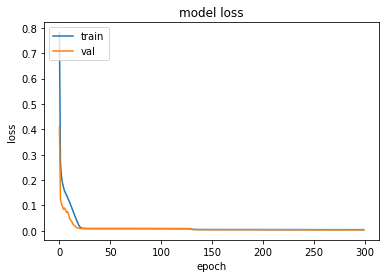

In [477]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

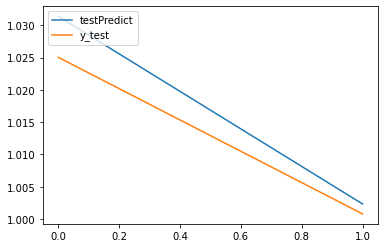

In [478]:
#plt.plot(scaler.inverse_transform(df_outer))
trainPredict = model.predict(X_train)
testPredict = model.predict(X_test)
#plt.plot(trainPredict[99])
plt.plot(testPredict[6])
plt.plot(y_test[6])
plt.legend(['testPredict', 'y_test' ], loc= 'upper left' ) 

plt.show()

In [458]:
y_test[97]

array([1.02381428, 1.00161129])

In [446]:
testPredict[97]

array([1.0298295, 1.0020516], dtype=float32)

In [459]:
#lstm_NOT_home_cyclic['geom_x_median']=lstm_NOT_home_cyclic['geom_x']/lstm_NOT_home_cyclic["geom_x"].median()
#lstm_NOT_home_cyclic['geom_y_median']=lstm_NOT_home_cyclic['geom_y']/lstm_NOT_home_cyclic["geom_y"].median()
1.02381428*lstm_NOT_home_cyclic["geom_x"].median()

300077.4489696791

In [460]:
1.00161129*lstm_NOT_home_cyclic["geom_y"].median()

2769169.878096632

In [447]:
1.0298295*lstm_NOT_home_cyclic["geom_x"].median()

301840.49516648677

In [448]:
1.0020516*lstm_NOT_home_cyclic["geom_y"].median()

2770387.209811238

In [461]:
#(298277.1090416227,2766451.278424568)
df = pd.DataFrame(
    {'Latitude': [2769169.878096632,2770387.209811238],
     'Longitude': [300077.4489696791,301840.49516648677]})
gdf = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df.Longitude, df.Latitude))
gdf.crs = {'init' :'epsg:3826'} # 避免資料沒設，這邊再重新給一次
gdf['geometry']

C:\Users\GIS519\Anaconda3\envs\python38\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


0    POINT (300077.449 2769169.878)
1    POINT (301840.495 2770387.210)
Name: geometry, dtype: geometry

<AxesSubplot:>

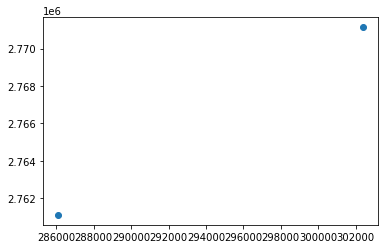

In [513]:
gdf.plot()

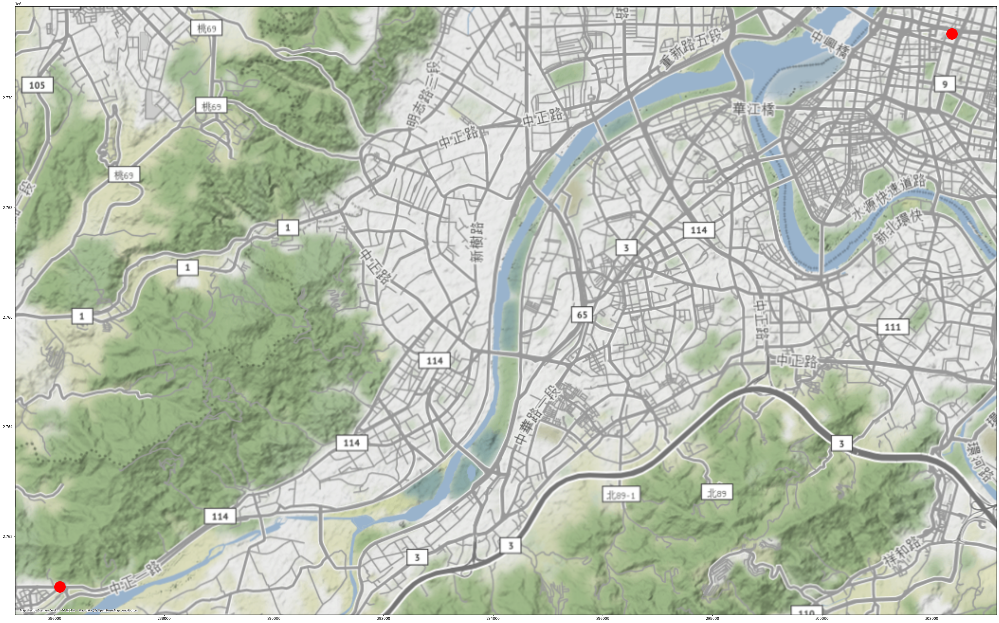

In [521]:
ac=gdf.plot(figsize=(50,50), color='red', markersize=1000)#figsize=(60,60)
cx.add_basemap(ax=ac,crs='EPSG:3826')

# 誤差值

In [500]:
#df_outer.iloc[0:,3:]
#x=device_id_x	geom_x_median_y	geom_y_median_y	date_part_sin	hr_sin
#y=geom_x_median_x ,geom_y_median_x
AllX_df = pd.DataFrame(AllX, columns = ['device_id','geom_x_median_y','geom_y_median_y','date_part_sin','hr_sin'])
AllY_df = pd.DataFrame(AllY, columns = ['geom_y_median_y','date_part_sin'])
AllX_df['geom_x_median_y'].map(lambda x: x*2)
#AllX_gdf = gpd.GeoDataFrame(AllX_df, geometry=gpd.points_from_xy(df.Longitude, df.Latitude))
#gdf.crs = {'init' :'epsg:3826'} # 避免資料沒設，這邊再重新給一次
#gdf['geometry']

ValueError: Must pass 2-d input. shape=(27245, 4, 4)

In [ ]:
alltPredict

In [492]:
look_back = 4
AllX, AllY = create_dataset(df_outer, look_back)

array([[ 1.01282475,  1.00272383, -0.78183148, -0.97908409],
       [ 1.01282485,  1.00272374, -0.78183148, -0.94226092],
       [ 1.01282623,  1.00272381, -0.78183148, -0.94226092],
       [ 1.01282894,  1.00272298, -0.78183148, -0.81696989]])

In [495]:
alltPredict = model.predict(AllX)

In [496]:
distdiff_list=[]
for i in range(len(y_test)):

    PX_test, PY_test = y_test[i]
    PX_test = PX_test*lstm_NOT_home_cyclic["geom_x"].median()
    PY_test = PY_test*lstm_NOT_home_cyclic["geom_y"].median()
    #testPredict[sample]
    PX_pred, PY_pred = alltPredict[i]
    PX_pred = PX_pred*lstm_NOT_home_cyclic["geom_x"].median()
    PY_pred = PY_pred*lstm_NOT_home_cyclic["geom_y"].median()

    df = pd.DataFrame(
        {'Latitude': [PY_test,PY_pred],
         'Longitude':[PX_test,PX_pred] })
    gdf = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df.Longitude, df.Latitude))
    gdf.crs = 'epsg:3826' # 避免資料沒設，這邊再重新給一次
    distdiff_list.append(gdf['geometry'][0].distance(gdf['geometry'][1]))

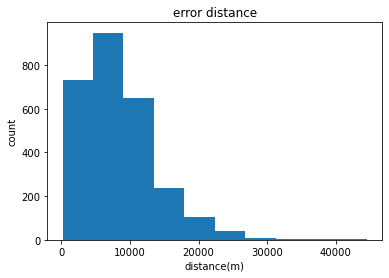

In [526]:
distdiff_list=np.array(distdiff_list)
plt.hist(distdiff_list)

plt.title("error distance")
plt.xlabel("distance(m)")
plt.ylabel("count")
plt.show()

In [498]:
distdiff_list.mean()

8343.12468817443

# create and fit the LSTM network
model = Sequential()
model.add(LSTM(40, input_shape=(trainX.shape[1], trainX.shape[2])))
model.add(Dense(3))
model.compile(loss='mean_squared_error', optimizer='adam')
model.fit(trainX, trainY, epochs=100, batch_size=60, verbose=2, shuffle=False)

# make predictions
trainPredict = model.predict(trainX)
testPredict = model.predict(testX)
# invert predictions

trainPredict = scaler.inverse_transform(trainPredict)

trainY = scaler.inverse_transform([trainY])

testPredict = scaler.inverse_transform(testPredict)

testY = scaler.inverse_transform([testY])
# calculate root mean squared error
trainScore = math.sqrt(mean_squared_error(trainY[0], trainPredict[:,0]))
print('Train Score: %.2f RMSE' % (trainScore))
testScore = math.sqrt(mean_squared_error(testY[0], testPredict[:,0]))
print('Test Score: %.2f RMSE' % (testScore))

In [ ]:
X_train.shape

In [ ]:
#trainPredict.shape

In [ ]:
trainPredict = model.predict(X_train)
testPredict = model.predict(X_test)
#nsamples, nx, ny = dataset.shape
#d2_dataset = dataset.reshape((nsamples,nx*ny))
#scaler = MinMaxScaler(feature_range=(0, 1)).fit(dataset)
#yscaler = MinMaxScaler(feature_range=(0, 1)).fit(dataset.iloc[1:,0:3])
#x_scaler1= MinMaxScaler(feature_range=(0, 1)).fit(dataset.iloc[0:-1])

#trainPredict_r = yscaler.inverse_transform(trainPredict)
#trainPredict
#trainPredict_r[:,0:1].astype(int)
#X_train[:,0,0:3]

In [ ]:
#nsamples, nx, ny = trainY.shape
#d2_trainY = trainY.reshape((nsamples,nx*ny))
#trainY_scaler = MinMaxScaler(feature_range=(0, 1)).fit(trainY)
#yscaler = MinMaxScaler(feature_range=(0, 1)).fit(dataset.iloc[1:,0:3])
#trainY = yscaler.inverse_transform(y_train)
#trainY
#x_scaler1.inverse_transform(X_test[:,0,:]).astype(int)[:,0]

In [ ]:
Xs = X_test.astype(int)[:,0,0]

In [ ]:
#trainPredict = model.predict(trainX)
#testPredict = model.predict(X_test)
#nsamples, nx, ny = testPredict.shape
#d2_testPredict= testPredict.reshape((nsamples,nx*ny))
#testX_scaler2 = MinMaxScaler(feature_range=(0, 1)).fit(testPredict)
#yscaler = MinMaxScaler(feature_range=(0, 1)).fit(dataset.iloc[1:,0:3])

yS = testPredict.astype(int)[:,0]# = yscaler.inverse_transform(testPredict)

In [ ]:
plt.hist((yS[:-1]-Xs[1:]),bins=300)
plt.show()

In [ ]:
#nsamples, nx, ny = testY.shape
#d2_testY = testY.reshape((nsamples,nx*ny))
#testY_scaler = MinMaxScaler(feature_range=(0, 1)).fit(testY)
yscaler = MinMaxScaler(feature_range=(0, 1)).fit(dataset.iloc[1:,0:3])
testY = yscaler.inverse_transform(y_test)

In [ ]:
X_train[0,:,0:3]

In [ ]:
X_train[0:1]

In [ ]:
import numpy

numpy.mean(numpy.abs((X_train[0,:,0:3] - trainPredict[0]) / X_train[0,:,0:3])) * 100

In [ ]:
trainScore = math.sqrt(mean_squared_error(trainY[0], trainPredict[0]))
print('Train Score: %.2f RMSE' % (trainScore))
testScore = math.sqrt(mean_squared_error(testY[0], testPredict[0]))
print('Test Score: %.2f RMSE' % (testScore))

In [ ]:
# shift train predictions for plotting
look_back=1
trainPredictPlot = numpy.empty_like(dataset)
trainPredictPlot[:, :] = numpy.nan
trainPredictPlot[look_back:len(trainPredict)+look_back, :] = trainPredict
# shift test predictions for plotting
testPredictPlot = numpy.empty_like(dataset)
testPredictPlot[:, :] = numpy.nan
testPredictPlot[len(trainPredict)+(look_back*2)+1:len(dataset)-1, :] = testPredict
# plot baseline and predictions
plt.plot(scaler.inverse_transform(dataset))
plt.plot(trainPredictPlot)
plt.plot(testPredictPlot)
plt.show()

In [ ]:
print(dataset)
print('--------------------------------------')
scaler = MinMaxScaler(feature_range=(0, 1))#範圍
x_scaler = scaler.fit_transform(dataset)#轉歸一化
print('--------------------------------------')
print(x_scaler)#轉歸一化
X1=scaler.inverse_transform(x_scaler)#正常
print('--------------------------------------')
print(X1)#轉回原來數值

In [ ]:
testX[0:1]

In [ ]:
#轉成二維
nsamples, nx, ny = X_test[0:1].shape
d2_testX_1 = X_test[0:1].reshape((nsamples,nx*ny))
#範圍
scaler_testX_1 = MinMaxScaler(feature_range=(0, 1)).fit(dataset)
#轉回正常
testX_inverse_transform = scaler_testX_1.inverse_transform(d2_testX_1)
testX_inverse_transform.astype(int)

In [ ]:
print(d2_testtest.shape)
print(dataset.shape)

In [ ]:
X_test[1:2].shape

In [ ]:
#X_test[:,:,0:3]
#X_test[1:2]
nsamples, nx, ny = X_test.shape
d2_testX_1 = X_test.reshape((nsamples,nx*ny))
#範圍
#scaler_testX_1 = MinMaxScaler(feature_range=(0, 1)).fit(dataset)
#轉回正常
testX_inverse_transform = x_scaler1.inverse_transform(d2_testX_1)
testX_inverse_transform

In [ ]:
#trainPredict = model.predict(trainX)
testtest =  model.predict(X_test)
#nsamples, nx, ny = testtest
#d2_testtest= testtest.reshape((nsamples,nx*ny))
#testtest_scaler = MinMaxScaler(feature_range=(0, 1)).fit(testtest)

testtest_inverse_transform = yscaler.inverse_transform(testtest)
testtest_inverse_transform

In [ ]:
#one_user
one_user[one_user["center_y_median"].between(1.00246,1.00247)]

In [ ]:
dataset[dataset["distance"].between(110,116)]

In [ ]:
0.00299887, 1.1258132 , 0.7812115

In [ ]:
import numpy as np
np.sin((2*np.pi*5/7))

In [ ]:
distance	angle_sin	angle_cos	radius	km2	hr_sin	hr_cos	date_part_sin	date_part_cos	geom_x_median	geom_y_median	center_x_median	center_y_median